In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from pandas.api.types import is_numeric_dtype

In [2]:
!pip install tensorflow

  Obtaining dependency information for flatbuffers>=2.0 from https://files.pythonhosted.org/packages/6f/12/d5c79ee252793ffe845d58a913197bfa02ae9a0b5c9bc3dc4b58d477b9e7/flatbuffers-23.5.26-py2.py3-none-any.whl.metadata
  Using cached flatbuffers-23.5.26-py2.py3-none-any.whl.metadata (850 bytes)
  Obtaining dependency information for libclang>=13.0.0 from https://files.pythonhosted.org/packages/ea/df/55525e489c43f9dbb6c8ea27d8a567b3dcd18a22f3c45483055f5ca6611d/libclang-16.0.6-py2.py3-none-manylinux2010_x86_64.whl.metadata
  Using cached libclang-16.0.6-py2.py3-none-manylinux2010_x86_64.whl.metadata (5.2 kB)
  Using cached tensorflow_estimator-2.11.0-py2.py3-none-any.whl (439 kB)
  Using cached termcolor-2.3.0-py3-none-any.whl (6.9 kB)
  Obtaining dependency information for tensorflow-io-gcs-filesystem>=0.23.1 from https://files.pythonhosted.org/packages/a4/c0/f9ac791c3f6f58a343b350894a3e92d44e53d20d7cf205988279ebcbc6e5/tensorflow_io_gcs_filesystem-0.33.0-cp37-cp37m-manylinux_2_12_x86_64.

In [3]:
import tensorflow as tf

2023-08-31 01:52:31.931614: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-08-31 01:52:33.369451: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda/lib64:/usr/local/cuda/lib:/usr/local/lib/x86_64-linux-gnu:/usr/local/nvidia/lib:/usr/local/nvidia/lib64:/usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-08-31 01:52:33.369668: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such 

In [4]:
pd.options.mode.chained_assignment = None 

In [5]:
!pip install keras

In [6]:
!pip install scikeras

  Using cached scikeras-0.10.0-py3-none-any.whl (27 kB)


In [7]:
import keras
from keras.models import Sequential, Model
from keras.layers import Input, Dense, Activation, Dropout, Flatten, Embedding, LSTM, Concatenate
from keras.layers.convolutional import Conv1D, MaxPooling1D
from keras.callbacks import ModelCheckpoint, EarlyStopping

In [8]:
import sklearn
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score

In [9]:
!pip install livelossplot
from livelossplot.tf_keras import PlotLossesCallback

  Using cached livelossplot-0.5.5-py3-none-any.whl (22 kB)
  Using cached bokeh-2.4.3-py3-none-any.whl (18.5 MB)


In [10]:
!pip install shap
import shap

  Obtaining dependency information for shap from https://files.pythonhosted.org/packages/b8/d8/15066ae71ba63683b8e53a8bef0e75bd87e95b79ef293f63fa674b351d9b/shap-0.42.1-cp37-cp37m-manylinux_2_12_x86_64.manylinux2010_x86_64.manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
  Using cached shap-0.42.1-cp37-cp37m-manylinux_2_12_x86_64.manylinux2010_x86_64.manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (23 kB)
  Using cached slicer-0.0.7-py3-none-any.whl (14 kB)
Using cached shap-0.42.1-cp37-cp37m-manylinux_2_12_x86_64.manylinux2010_x86_64.manylinux_2_17_x86_64.manylinux2014_x86_64.whl (545 kB)


Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


In [11]:
from google.cloud import bigquery

---------

### Authentication for working from Google Colab

In [12]:
# from google.colab import auth
# auth.authenticate_user()

---------

### Destination to save trained models

#### Google disk

In [13]:
# from google.colab import drive

# drive.mount('/content/gdrive')
# project_folder_path = '/content/gdrive/Shareddrives/Magisterka/PROJEKT/'
# models_path = project_folder_path + '/models'

#### Vertex AI Jupyter Lab

In [14]:
data_analysis_folder_path = '../'
models_path = data_analysis_folder_path + '/models'

---------

### Connect to Bigquery service

In [15]:
import sys
sys.path.append("./../../")
from gcp_env import PROJECT_ID, LOCATION

In [16]:
project_id = PROJECT_ID # Fill project id
bqclient = bigquery.Client(location=LOCATION, project=project_id)

# Users data

-----

## Loading data

In [17]:
dataset_name = "twitbot_22_preprocessed_common_users_ids"

users_table_name = "users"
BQ_TABLE_USERS = dataset_name + "." + users_table_name
users_table_id = project_id + "." + BQ_TABLE_USERS

In [18]:
dataset_name = "twitbot_22_preprocessed_common_users_ids"

users_table_name = "users"
BQ_TABLE_USERS = dataset_name + "." + users_table_name
users_table_id = project_id + "." + BQ_TABLE_USERS

In [19]:
# job_config = bigquery.QueryJobConfig(
#     allow_large_results=True, destination=users_table_id, use_legacy_sql=True
# )

In [20]:
SQL_QUERY = f"""WITH 
  human_records AS (
    SELECT *, ROW_NUMBER() OVER () row_num 
    FROM {BQ_TABLE_USERS}
    WHERE label = 'human' 
    LIMIT 5000),
  bot_records AS (
  SELECT *, ROW_NUMBER() OVER () row_num 
    FROM {BQ_TABLE_USERS}
    WHERE label = 'bot' 
    LIMIT 5000)
  SELECT * FROM human_records 
    UNION ALL SELECT * 
    FROM bot_records 
    ORDER BY row_num;"""

users_df1 = bqclient.query(SQL_QUERY).to_dataframe()
users_df1 = users_df1.drop(['row_num'], axis=1)

In [21]:
# LIMIT RESULTS OPTIONS
pd.set_option('display.max_rows', 100)
# pd.set_option('display.max_rows', None)
pd.set_option('display.max_column', None)
pd.set_option('display.max_colwidth', None)

In [22]:
num_bots = len(users_df1.loc[users_df1['label']=='bot'])       # bots number
num_humans = len(users_df1.loc[users_df1['label']=='human'])   # humans number

print("Number of real users: ", num_humans)
print("Number of bots: ", num_bots)

Number of real users:  5000
Number of bots:  5000


In [23]:
org_users_df = pd.DataFrame(users_df1).copy()
users_df2 = pd.DataFrame(org_users_df).copy()

In [24]:
def filter_df_for_balanced_classes(df, bot_label_value='bot', human_label_value='human'):
    new_df = pd.DataFrame()

    i = 0 # bots iter.
    j = 0 # humans iter.
    k = 0
    num_bots = len(df.loc[df['label']==bot_label_value])
    num_humans = len(df.loc[df['label']==human_label_value])
    max_num = min(num_bots, num_humans)
    for index, record in df.iterrows():
      if k < (2*max_num):
        if record['label']==bot_label_value and i < max_num:
          new_df = new_df.append(record)
          # users_df = pd.concat([users_df, record], ignore_index=True)
          i += 1
          k += 1
        if record['label']==human_label_value and j < max_num:
          new_df = new_df.append(record)
          # users_df = pd.concat([users_df, record], ignore_index=True)
          j += 1
          k += 1
            
    print("Number of bots: ", len(new_df.loc[new_df['label']==bot_label_value]))
    print("Number of human users: ", len(new_df.loc[new_df['label']==human_label_value]))
    
    return pd.DataFrame(new_df).copy();

In [25]:
# users_df = filter_df_for_balanced_classes(users_df2)
users_df = pd.DataFrame(users_df2).copy()

## Data preparation

In [26]:
def drop_columns(df, columns):
    for column_name in columns:
      df = df.drop([column_name], axis=1)
    return df

In [27]:
def encode_not_numeric_columns(df):
  for column_name in df:
    if not is_numeric_dtype(df[column_name]):
      unique_values_dict = dict(enumerate(df[column_name].unique()))
      unique_values_dict = dict((v, k) for k, v in unique_values_dict.items())
      df[column_name] = df[column_name].map(unique_values_dict)
  return df

#### Align values for bool columns

In [28]:
boolean_columns = ["verified", "protected", "withheld", "has_location", "has_profile_image_url", "has_pinned_tweet", "has_description"]

In [29]:
# Firstly align boolean columns values
for col_name in boolean_columns:
    users_df[col_name] = users_df[col_name].astype(bool)

column_to_remove = []
# Check unique values (some of subset can have only one unique value for some feature) if so it column will be removed from dataframe
for col_name in boolean_columns:
    uniq_val_list = users_df[col_name].unique()
    print("Column {:<24} {}".format(col_name, str(uniq_val_list)))
    if (len(uniq_val_list) < 2):
        column_to_remove.append(col_name)

Column verified                 [False  True]
Column protected                [False  True]
Column withheld                 [False]
Column has_location             [ True False]
Column has_profile_image_url    [ True False]
Column has_pinned_tweet         [False  True]
Column has_description          [ True False]


In [30]:
column_to_remove

['withheld']

In [31]:
# remove from bool columns:
for col_name in column_to_remove:
    boolean_columns.remove(col_name)
# remove from dataframe
users_df = drop_columns(users_df, column_to_remove)

### Encoding of non-numeric information which will be used by model

In [32]:
# Remap the values of the dataframe
for col_name in boolean_columns:
  users_df[col_name] = users_df[col_name].map({True:1,False:0})

# Remap label values human/bot for 0/1
label_col = "label"
users_df[label_col] = users_df[label_col].map({"human":0,"bot":1})

In [33]:
users_df

,id,label,username,name,created_at,verified,protected,has_location,location,has_profile_image_url,has_pinned_tweet,url,followers_count,following_count,tweet_count,listed_count,has_description,description,descr_no_hashtags,descr_no_cashtags,descr_no_mentions,descr_no_urls,url_no_urls
0,1428769922507751429,1,BotoxAesthetics,dermalfillers Aesthetics botox,1629480285,0,0,1,"London , United Kingdom",1,0,https://t.co/CBDBvXnRKv,2,41,1,0,1,"Enhance fillers is a progressive company found in the city of Webminster,We offer a wide range of aesthetic services including Botox, Dysport, Xeomin,the Juvede",0,0,0,0,1
1,1484544053572419585,0,blessing_xettry,#Blessing xettry,1642777877,0,0,1,Nepal,1,0,,0,24,1,0,1,"Okay, well, maybe not forever. But at least until you make some changes.",0,0,0,0,0
2,842202106324951040,1,Mark11474609,Mark,1489631604,0,0,1,"Kelvin Grove, Brisbane",1,0,,3,22,4,0,0,,0,0,0,0,0
3,1447956502443069446,0,menametaken,winwinnie,1634054741,0,0,1,your walls,1,0,,0,20,1,0,1,20 | uni student | life goes brrr \nyes I do and it's called art\n#thickthighssavelifes,1,0,0,0,0
4,21309002,1,Sjouzan,Zuzana,1235058272,0,0,1,"Brighton, UK",1,0,,3,42,2,0,0,,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,3275187061,0,LZconcussion,Concussion Recovery,1436585642,0,0,1,"Park City, UT",1,1,https://t.co/KpjP54TOGR,352,190,1094,18,1,"Specializing in #concussionmanagement including #education, #therapy options / recommendations & our standardized #ReturntoLifeandSport #exerciseprogression",5,0,0,0,1
9996,1485289449487572996,1,davie73smith,Davie,1642955586,0,0,0,None,1,0,,0,34,0,0,1,F U N,0,0,0,0,0
9997,1215382704876871680,0,USC_TrueVote,USC Election Cybersecurity Initiative,1578604840,0,0,1,washington dc,1,0,https://t.co/jlreKFwVEc,608,1265,1095,11,1,"Platform, party, and vendor-agnostic.\nOur candidate is democracy. ����\nTraining in all 50 states ✈ �� ��\nSupport from @google\nUpcoming Training Events ��",0,0,1,0,1
9998,1480725883820208131,1,Theresa823,Theresa Coleman,1641867569,0,0,0,None,1,0,,0,5,0,0,0,,0,0,0,0,0


#### Null and NaN statistics

In [34]:
for col_name in users_df:
    count1 = pd.isnull(users_df[col_name]).sum()
    print(col_name + ": " + str(count1))

id: 0
label: 0
username: 0
name: 0
created_at: 0
verified: 0
protected: 0
has_location: 0
location: 3476
has_profile_image_url: 0
has_pinned_tweet: 0
url: 0
followers_count: 0
following_count: 0
tweet_count: 0
listed_count: 0
has_description: 0
description: 0
descr_no_hashtags: 0
descr_no_cashtags: 0
descr_no_mentions: 0
descr_no_urls: 0
url_no_urls: 0


#### Extract some information from dataframe to new columns

##### Description length

In [35]:
users_df['descr_len'] = users_df['description'].apply(len).astype(float)

##### Account age (in days) (sice 16.03.2022) (dataset data collected during the 20/01-15/03/2022 period)

In [36]:
from datetime import datetime

In [37]:
def cal_days_diff(a,b):
    A = a.replace(hour = 0, minute = 0, second = 0, microsecond = 0)
    B = b.replace(hour = 0, minute = 0, second = 0, microsecond = 0)
    return (A - B).days

def convert_unixtime_to_datetime(a):
    return datetime.utcfromtimestamp(a)

In [38]:
base_date = datetime(2022, 3, 16)
users_df['account_age'] = users_df.apply(lambda x: cal_days_diff(base_date, convert_unixtime_to_datetime(x.created_at)), axis=1).astype(float)

#### Reduce unnecessary columns

In [39]:
# users_reduced_df = pd.DataFrame(users_df).copy()
# # columns_to_drop = ["id", "username", "name", "created_at", "location", "url", "description"]
# columns_to_drop = ["username", "name", "created_at", "location", "url", "description"]
# users_reduced_df = drop_columns(users_reduced_df, columns_to_drop)
# users_reduced_df

### Filter data, left column by feature importance based on SHAP results

In [40]:
shap_features = ['followers_count', 'tweet_count', 'following_count', 'account_age', 'descr_len']

In [41]:
users_reduced_df = users_df.copy()
users_reduced_df = users_df.filter(['label', 'id']+shap_features)
users_reduced_df

,label,id,followers_count,tweet_count,following_count,account_age,descr_len
0,1,1428769922507751429,2,1,41,208.0,160.0
1,0,1484544053572419585,0,1,24,54.0,72.0
2,1,842202106324951040,3,4,22,1826.0,0.0
3,0,1447956502443069446,0,1,20,155.0,85.0
4,1,21309002,3,2,42,4773.0,0.0
...,...,...,...,...,...,...,...
9995,0,3275187061,352,1094,190,2440.0,156.0
9996,1,1485289449487572996,0,0,34,52.0,5.0
9997,0,1215382704876871680,608,1095,1265,797.0,153.0
9998,1,1480725883820208131,0,0,5,64.0,0.0


### Data type conversion (to float)

In [42]:
for (column_name, column_data) in users_reduced_df.iteritems():
    if (column_name != 'id'):
        users_reduced_df[column_name] = users_reduced_df[column_name].astype(float)

### Data split for training, validation and testing of users data

In [43]:
train_users_data, test_users_data = train_test_split(users_reduced_df, test_size=0.30, random_state=25, shuffle=True)
test_users_data, val_users_data = train_test_split(test_users_data, test_size=0.5, random_state=25, shuffle=True)

### Describe trainig dataset of users dataset

In [44]:
train_users_data.describe()

,label,followers_count,tweet_count,following_count,account_age,descr_len
count,7000.000000,7.000000e+03,7.000000e+03,7000.000000,7000.000000,7000.000000
mean,0.503857,6.229971e+03,6.554910e+03,1253.036286,2442.663000,84.592000
std,0.500021,4.412925e+04,3.316229e+04,6121.951212,1640.465006,59.651674
min,0.000000,0.000000e+00,0.000000e+00,0.000000,22.000000,0.000000
25%,0.000000,3.300000e+01,2.200000e+01,74.000000,818.000000,23.000000
50%,1.000000,2.710000e+02,5.015000e+02,269.000000,2407.000000,95.000000
75%,1.000000,1.565500e+03,3.310500e+03,899.000000,3995.000000,143.000000
max,1.000000,1.730667e+06,1.184641e+06,244195.000000,5724.000000,243.000000


#### Describes training users data for bots

In [45]:
train_users_data.loc[train_users_data['label']==1].describe()

,label,followers_count,tweet_count,following_count,account_age,descr_len
count,3527.0,3527.000000,3527.000000,3527.000000,3527.000000,3527.000000
mean,1.0,2016.999716,2185.104338,770.499008,2060.185143,67.609300
std,0.0,19503.794857,11279.654017,4195.024713,1565.122289,62.244412
min,1.0,0.000000,0.000000,0.000000,30.000000,0.000000
25%,1.0,14.000000,7.000000,41.000000,604.000000,0.000000
50%,1.0,81.000000,127.000000,140.000000,1776.000000,58.000000
75%,1.0,410.000000,1086.000000,431.000000,3446.500000,134.000000
max,1.0,702018.000000,497641.000000,150720.000000,5484.000000,243.000000


#### Describes training users data for humans

In [46]:
train_users_data.loc[train_users_data['label']==0].describe()

,label,followers_count,tweet_count,following_count,account_age,descr_len
count,3473.0,3.473000e+03,3.473000e+03,3473.000000,3473.000000,3473.000000
mean,0.0,1.050845e+04,1.099266e+04,1743.076303,2831.087820,101.838756
std,0.0,5.918594e+04,4.526135e+04,7563.173323,1624.084521,51.457456
min,0.0,0.000000e+00,0.000000e+00,0.000000,22.000000,0.000000
25%,0.0,1.570000e+02,1.700000e+02,159.000000,1343.000000,63.000000
50%,0.0,9.130000e+02,1.578000e+03,499.000000,3094.000000,115.000000
75%,0.0,3.610000e+03,6.601000e+03,1413.000000,4342.000000,149.000000
max,0.0,1.730667e+06,1.184641e+06,244195.000000,5724.000000,181.000000


# Data analysis

## Distribution of label class in training, validation and test set of users data

In [47]:
stack_data = {'Set': ['Training data', 'Validation data', 'Test data', 'Training data', 'Validation data', 'Test data'],
              'Label': ['Bot', 'Bot', 'Bot', 'Human', 'Human', 'Human'],
              'Freq': [len(train_users_data.loc[train_users_data['label']==1]), 
                       len(val_users_data.loc[val_users_data['label']==1]), 
                       len(test_users_data.loc[test_users_data['label']==1]),
                       len(train_users_data.loc[train_users_data['label']==0]), 
                       len(val_users_data.loc[val_users_data['label']==0]), 
                       len(test_users_data.loc[test_users_data['label']==0])]}
sdf = pd.DataFrame(stack_data)
sdf

,Set,Label,Freq
0,Training data,Bot,3527
1,Validation data,Bot,743
2,Test data,Bot,730
3,Training data,Human,3473
4,Validation data,Human,757
5,Test data,Human,770


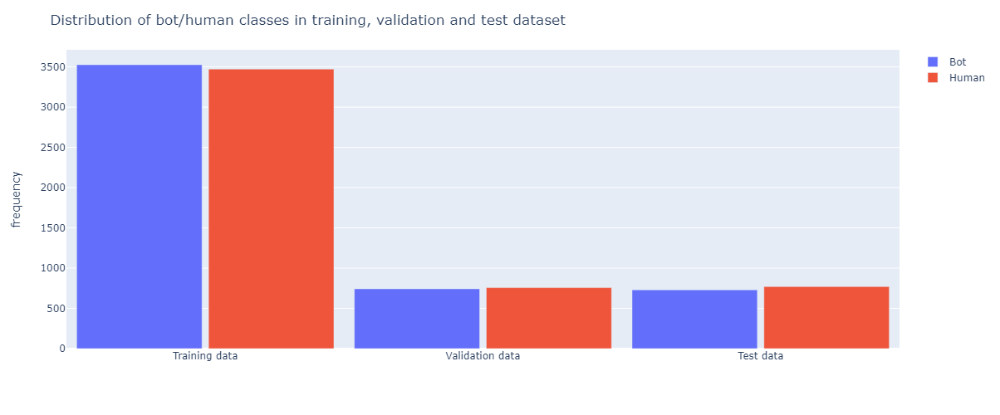

In [48]:
fig = px.bar(sdf, x="Set", y="Freq",
             color="Label", hover_data=['Label'],
             barmode = 'group')
fig.update_layout(
    title_text='Distribution of bot/human classes in training, validation and test dataset',
    xaxis_title_text='', #'subset',
    yaxis_title_text='frequency',
    bargap=0.05,
    bargroupgap=0.05,
    width=700,
    height=500,
    legend={"title":""})
fig.show()

## Distribution of other features in training dataset

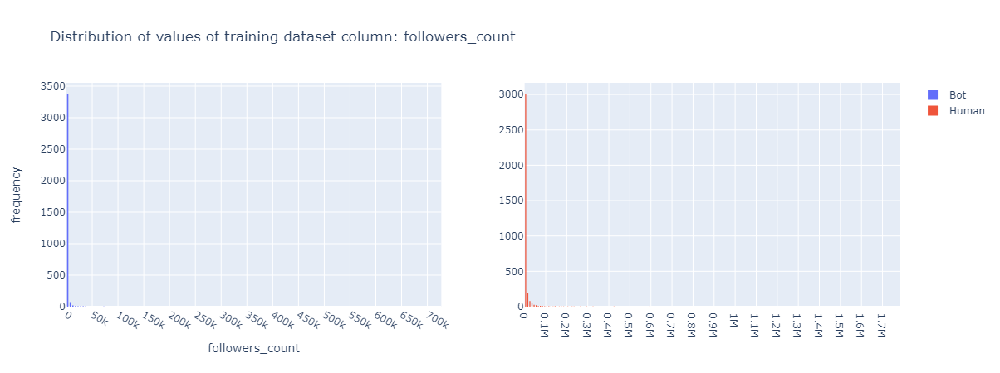

In [49]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_users_data.loc[train_users_data['label']==1,'followers_count'],
    # histnorm='density',
    nbinsx=200,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_users_data.loc[train_users_data['label']==0,'followers_count'],
    # histnorm='density',
    nbinsx=200,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training dataset column: followers_count',
    xaxis_title_text='followers_count', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='followers_count', dtick=50000, range=[0, max(train_users_data.loc[train_users_data['label']==1,'followers_count'])+25000]),
    xaxis2=dict(showgrid=True, dtick=100000, range=[0, max(train_users_data.loc[train_users_data['label']==0,'followers_count'])+50000]),
    yaxis=dict(showgrid=True))

fig.show()

In [50]:
len(train_users_data[(train_users_data['label']==1)])

3527

In [51]:
len(train_users_data[(train_users_data['label']==0)])

3473

In [52]:
from scipy.stats import expon

# Fit an exponential distribution to data
loc_b, scale_b = expon.fit(train_users_data.loc[train_users_data['label']==1]['followers_count'])
loc_h, scale_h = expon.fit(train_users_data.loc[train_users_data['label']==0]['followers_count'])

# Calculate the 99th percentile using the percent-point function (inverse CDF)
percentile_99_bots = expon.ppf(0.99, loc=loc_b, scale=scale_b)
percentile_99_humans = expon.ppf(0.99, loc=loc_h, scale=scale_h)
df_reduced_outliers_followers_count = train_users_data[((train_users_data['label']==1) & (train_users_data['followers_count'] < percentile_99_bots)) | ((train_users_data['label']==0) & (train_users_data['followers_count'] < percentile_99_humans))]
df_filtered_bots = train_users_data[(train_users_data['label']==1) & (train_users_data['followers_count'] < percentile_99_bots)]
df_filtered_humans = train_users_data[(train_users_data['label']==0) & (train_users_data['followers_count'] < percentile_99_humans)]

In [53]:
def df_99_percentile(df, column_name):
    # Fit an exponential distribution to data
    loc_b, scale_b = expon.fit(df.loc[df['label']==1][column_name])
    loc_h, scale_h = expon.fit(df.loc[df['label']==0][column_name])

    # Calculate the 99th percentile using the percent-point function (inverse CDF)
    percentile_99_bots = expon.ppf(0.99, loc=loc_b, scale=scale_b)
    percentile_99_humans = expon.ppf(0.99, loc=loc_h, scale=scale_h)
    return df[((df['label']==1) & (df[column_name] < percentile_99_bots)) | ((df['label']==0) & (df[column_name] < percentile_99_humans))]

#### following_count

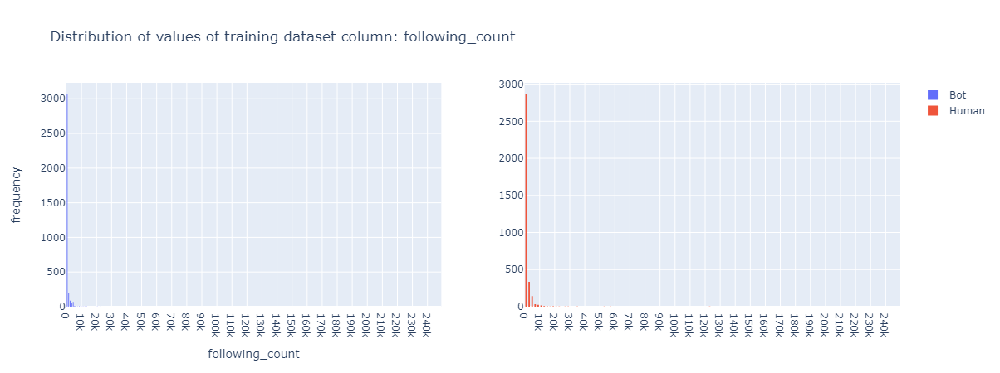

In [54]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_users_data.loc[train_users_data['label']==1,'following_count'],
    # histnorm='density',
    nbinsx=200,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_users_data.loc[train_users_data['label']==0,'following_count'],
    # histnorm='density',
    nbinsx=200,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training dataset column: following_count',
    xaxis_title_text='following_count', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True, dtick=10000, range=[0, max(train_users_data['following_count'])+5000]),
    xaxis2=dict(showgrid=True, dtick=10000, range=[0, max(train_users_data['following_count'])+5000]),
    yaxis=dict(showgrid=True))

fig.show()

#### tweet_count

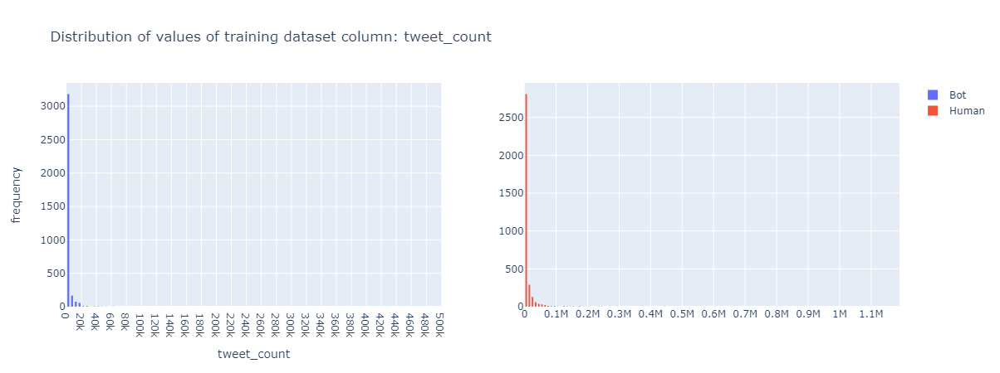

In [55]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_users_data.loc[train_users_data['label']==1,'tweet_count'],
    # histnorm='density',
    nbinsx=200,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_users_data.loc[train_users_data['label']==0,'tweet_count'],
    # histnorm='density',
    nbinsx=200,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training dataset column: tweet_count',
    xaxis_title_text='tweet_count', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True, dtick=20000),
    xaxis2=dict(showgrid=True, dtick=100000),
    yaxis=dict(showgrid=True))

fig.show()

### descr_len

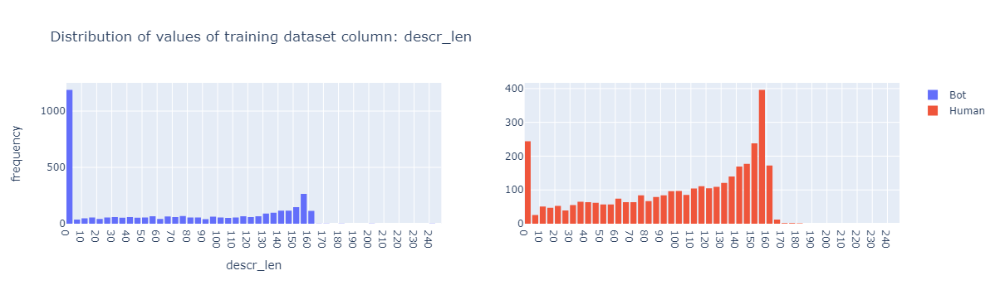

In [56]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_users_data.loc[train_users_data['label']==1,'descr_len'],
    # histnorm='density',
    # nbinsx=30,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_users_data.loc[train_users_data['label']==0,'descr_len'],
    # histnorm='density',
    # nbinsx=30,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training dataset column: descr_len',
    xaxis_title_text='descr_len', #'feature',
    yaxis_title_text='frequency',
    bargap=0.2,
    bargroupgap=None, #0.8,
    width=1100,
    height=350,
    legend={"title":""},
    xaxis=dict(showgrid=True, dtick=10, range=[0, max(train_users_data['descr_len'])+5]),
    xaxis2=dict(showgrid=True, dtick=10, range=[0, max(train_users_data['descr_len'])+5]),
    yaxis=dict(showgrid=True))

fig.show()

### account_age

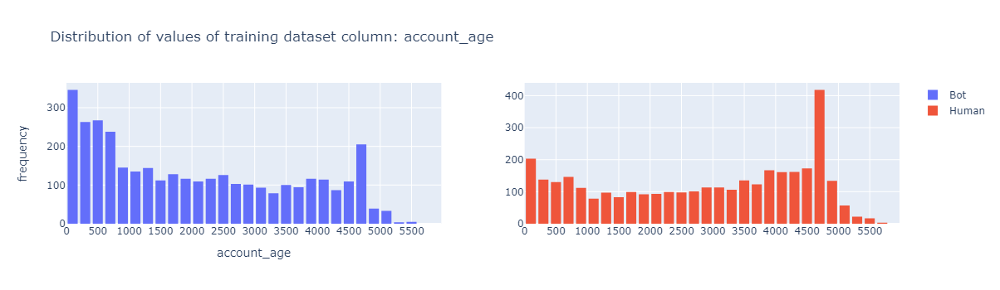

In [57]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_users_data.loc[train_users_data['label']==1,'account_age'],
    # histnorm='density',
    # nbinsx=30,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_users_data.loc[train_users_data['label']==0,'account_age'],
    # histnorm='density',
    # nbinsx=30,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training dataset column: account_age',
    xaxis_title_text='account_age', #'feature',
    yaxis_title_text='frequency',
    bargap=0.2,
    bargroupgap=None, #0.8,
    width=1100,
    height=350,
    legend={"title":""},
    xaxis=dict(showgrid=True, dtick=500, range=[0, max(train_users_data['account_age'])+250]),
    xaxis2=dict(showgrid=True, dtick=500, range=[0, max(train_users_data['account_age'])+250]),
    yaxis=dict(showgrid=True))

fig.show()

In [58]:
len(train_users_data)

7000

### Filter to have the same number of records for each class - part II

In [59]:
train_users_data = filter_df_for_balanced_classes(train_users_data, bot_label_value=1, human_label_value=0)
val_users_data = filter_df_for_balanced_classes(val_users_data, bot_label_value=1, human_label_value=0)
test_users_data = filter_df_for_balanced_classes(test_users_data, bot_label_value=1, human_label_value=0)

Number of bots:  3473
Number of human users:  3473
Number of bots:  743
Number of human users:  743
Number of bots:  730
Number of human users:  730


#### First drop columns in dataframes where there are same value in whole columns in training dataset

In [60]:
same_data_columns = list(train_users_data.columns[train_users_data.apply(lambda x: x.nunique()) == 1])
same_data_columns

[]

In [61]:
train_users_data = train_users_data.drop(same_data_columns, axis=1)

val_users_data = val_users_data.drop(same_data_columns, axis=1)
test_users_data = test_users_data.drop(same_data_columns, axis=1)

### Standardize data by column range of training set

In [62]:
def standardize_column(df, col_name, mean_training, std_training):
    df_cp = df.copy()
    df_cp[col_name] = (df[col_name] - mean_training) / std_training

    return df_cp

In [63]:
# columns_to_standardize = ['followers_count', 'following_count', 'tweet_count', 'descr_len', 'account_age']
columns_to_standardize = list(train_users_data.columns)
columns_to_standardize.remove('label')
columns_to_standardize.remove('id')

In [64]:
for column_name in columns_to_standardize:
    mean_training = train_users_data[column_name].mean()
    std_training = train_users_data[column_name].std()
    print("mean_training = ", column_name)
    print("mean_training = ", mean_training)
    print("std_training = ", std_training)

    train_users_data = standardize_column(train_users_data, column_name, mean_training, std_training)
    val_users_data = standardize_column(val_users_data, column_name, mean_training, std_training)
    test_users_data = standardize_column(test_users_data, column_name, mean_training, std_training)

mean_training =  followers_count
mean_training =  6208.796717535272
std_training =  44145.842669630874
mean_training =  tweet_count
mean_training =  6595.194212496401
std_training =  33286.69197462025
mean_training =  following_count
mean_training =  1259.0381514540743
std_training =  6144.786564521689
mean_training =  account_age
mean_training =  2443.6521739130435
std_training =  1640.571178505393
mean_training =  descr_len
mean_training =  84.77094730780306
std_training =  59.6092442340293


## Users data correlation

In [65]:
sns.set(font_scale=2)

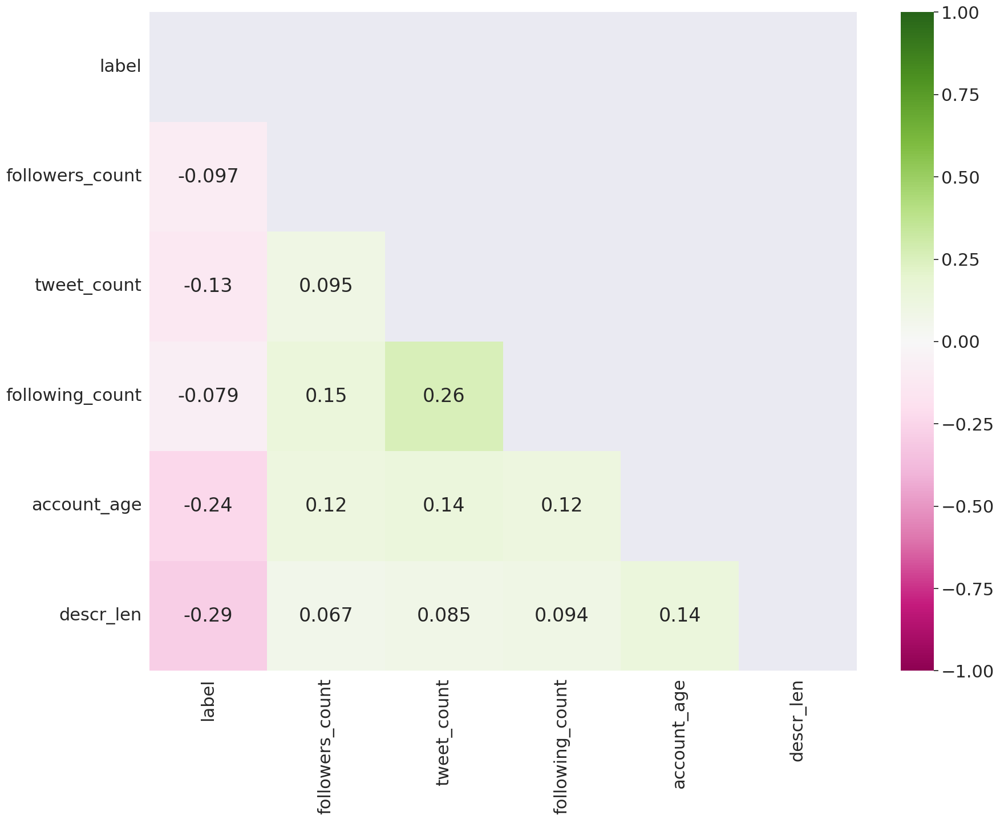

In [66]:
corr_threshold = 0.52
corr = train_users_data.drop(['id'], axis=1).corr()
lower_tri = corr.where(np.tril(np.ones(corr.shape),k=-1).astype(bool)) #creating lower triangular correlation matrix
f = plt.figure(figsize=(20, 15))
sns.heatmap(lower_tri, cmap="PiYG", annot=True, vmin=-1, vmax=1, ax=plt.gca()) #, annot_kws={"fontsize": 16})
high_corr = []
for column in train_users_data:
    if (column != 'id'):
        for col in train_users_data:
            if (col != 'id'):
                if abs(lower_tri[column][col]) > corr_threshold:
                    high_corr.append((column, col, lower_tri[column][col]))
high_corr = sorted(high_corr, key=lambda x: x[2], reverse=True)

In [67]:
sns.set(font_scale=1)

In [68]:
print("Number of columns containing high correlation:", len(set([x[0] for x in high_corr])))
high_corr

Number of columns containing high correlation: 0


[]

In [69]:
# train_users_data = train_users_data.drop(['listed_count'], axis=1)
# val_users_data = val_users_data.drop(['listed_count'], axis=1)
# test_users_data = test_users_data.drop(['listed_count'], axis=1)

# train_users_data = train_users_data.drop(['has_description'], axis=1)
# val_users_data = val_users_data.drop(['has_description'], axis=1)
# test_users_data = test_users_data.drop(['has_description'], axis=1)

In [70]:
train_users_data

,label,id,followers_count,tweet_count,following_count,account_age,descr_len
6625,0.0,1214018601683836928,-0.128094,-0.192545,-0.113436,-1.001878,1.043950
2489,0.0,109927809,-0.078032,-0.044047,0.038726,1.209547,1.111053
9919,0.0,2325624539,-0.092643,-0.120715,0.608965,0.315346,1.262037
6964,1.0,1362188147250061315,-0.140643,-0.198103,-0.196107,-1.250572,-1.422111
3467,0.0,1105810614935531521,-0.133711,-0.059549,-0.178369,-0.819624,0.993622
...,...,...,...,...,...,...,...
3325,0.0,1059189764,-0.128705,-0.129968,0.053210,0.557335,1.262037
1881,0.0,235022253,-0.116065,-0.046150,0.438414,1.001083,1.060726
4861,0.0,3053537383,-0.140371,-0.198013,-0.189598,0.078234,-0.616867
1175,0.0,4348813577,-0.139805,-0.197232,-0.155423,-0.090000,-1.422111


------
------

# Tweets data

------

## Loading data

In [71]:
tweets_table_name = "tweets"
BQ_TABLE_TWEETS = dataset_name + "." + tweets_table_name
tweets_table_id = project_id + "." + BQ_TABLE_TWEETS

In [72]:
# comma-separated string of user IDs from users dataframe
users_df0 = pd.DataFrame(users_df1).copy()
users_df0['id'] = users_df0['id'].astype(str)
user_ids = users_df0['id'].to_list()

# # SQL query to select records from the 'tweets' table
SQL_QUERY = f"""SELECT * FROM {BQ_TABLE_TWEETS} WHERE CAST(author_id AS STRING) IN ({str(user_ids)[1:-1]})"""

tweets_df1 = bqclient.query(SQL_QUERY).to_dataframe()

In [73]:
len(tweets_df1)

426163

In [74]:
tweets_df1

,id,author_id,created_at,org_text,text,source,withheld,copyright_infringement,is_reply,geo_tagged,latitude,longitude,conversation_id,reply_settings,retweet_count,reply_count,like_count,quote_count,any_polls_attached,any_media_attached,possibly_sensitive,has_referenced_tweets,media_attached,no_cashtags,no_mentions,no_user_mentions,user_mentions,no_urls,contains_images,contains_annotations,no_hashtags,hashtags,context_annotations_domain_id,context_annotations_domain_name,context_annotations_entity_id,context_annotations_entity_name
0,t871667974888988672,18456141,1496656814,10 things in tech you need to know today | https://t.co/iSQu4CN4rY via @BIUK_Tech #Tech #Morning #News,things in tech you need to know today | via biuktech tech morning news,Hootsuite,False,False,False,False,NaN,NaN,871667974888988672,None,2,0,1,0,False,False,False,False,False,0,0,0,[],1,False,False,3,"[{'tagname': 'Tech'}, {'tagname': 'Morning'}, {'tagname': 'News'}]",<NA>,None,<NA>,None
1,t1451246919590760454,50338306,1634839203,Shannon Minter is a groundbreaking transgender civil rights attorney who argued successfully before the U.S. Supreme Court. He serves as the legal director of the National Center for Lesbian Rights (NCLR). https://t.co/UAum4Bu2Ce https://t.co/ZYmY080vj3,shannon minter is a groundbreaking transgender civil rights attorney who argued successfully before the us supreme court he serves as the legal director of the national center for lesbian rights nclr,Sked Social,False,False,False,False,NaN,NaN,1451246919590760454,None,0,0,0,0,False,False,False,False,False,0,0,0,[],1,False,False,0,[],<NA>,None,<NA>,None
2,t1464338171211227141,50338306,1637960400,"For the LGBTQ community, the annual end-of-the-year holiday season traditionally kicks off with costumed Halloween parties at clubs and homes. https://t.co/NJ4CkorXuy",for the lgbtq community the annual endoftheyear holiday season traditionally kicks off with costumed halloween parties at clubs and homes,Sked Social,False,False,False,False,NaN,NaN,1464338171211227141,None,0,0,0,0,False,False,False,False,False,0,0,0,[],1,False,False,0,[],<NA>,None,<NA>,None
3,t1486051245441929219,50338306,1643137201,"André Leon Talley, an icon of fashion journalism, has died at the age of 73.\nBest known for his roles at Vogue as creative director and editor-at-large, which spanned from the 1980s to 2013. https://t.co/NQ7gZmfm21",andre leon talley an icon of fashion journalism has died at the age of best known for his roles at vogue as creative director and editoratlarge which spanned from the s to,Sked Social,False,False,False,False,NaN,NaN,1486051245441929219,None,0,0,0,0,False,False,False,False,False,0,0,0,[],1,False,False,0,[],<NA>,None,<NA>,None
4,t1449051082244739075,106526969,1634315674,"A month after Abbott issued a safety notice describing a defect that could cause some of its #COVID tests to return false positive results, the FDA has upgraded the issue into a Class I recall. https://t.co/OofNGRAVWg",a month after abbott issued a safety notice describing a defect that could cause some of its covid tests to return false positive results the fda has upgraded the issue into a class i recall,Twitter Web App,False,False,False,False,NaN,NaN,1449051082244739075,None,1,0,0,0,False,False,False,False,False,0,0,0,[],1,False,False,1,[{'tagname': 'COVID'}],<NA>,None,<NA>,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426158,t1494355678781374464,1298362221731274752,1645117132,Looking for a minimalist logo design? Get your quote- https://t.co/TeykKS5TyJ https://t.co/WFRLSEZe7o #logo #icon #company #minimalist #simple #design #premium #unique #sundayvibes #AskFFT #SundayMorning #Haiti #Pecan #Gaskin #Wilt #Mahomes #Ahmed #Fnatic #Miami #NEWTOT #Grass https://t.co/fHd5dCKGUb,looking for a minimalist logo design get your quote logo icon company minimalist simple design premium unique sundayvibes askfft sundaymorning

In [75]:
org_tweet_df = pd.DataFrame(tweets_df1).copy()
tweets_df = pd.DataFrame(org_tweet_df).copy()

In [76]:
tweets_df.columns

Index(['id', 'author_id', 'created_at', 'org_text', 'text', 'source',
       'withheld', 'copyright_infringement', 'is_reply', 'geo_tagged',
       'latitude', 'longitude', 'conversation_id', 'reply_settings',
       'retweet_count', 'reply_count', 'like_count', 'quote_count',
       'any_polls_attached', 'any_media_attached', 'possibly_sensitive',
       'has_referenced_tweets', 'media_attached', 'no_cashtags', 'no_mentions',
       'no_user_mentions', 'user_mentions', 'no_urls', 'contains_images',
       'contains_annotations', 'no_hashtags', 'hashtags',
       'context_annotations_domain_id', 'context_annotations_domain_name',
       'context_annotations_entity_id', 'context_annotations_entity_name'],
      dtype='object')

In [77]:
len(tweets_df)

426163

In [78]:
tweets_df

,id,author_id,created_at,org_text,text,source,withheld,copyright_infringement,is_reply,geo_tagged,latitude,longitude,conversation_id,reply_settings,retweet_count,reply_count,like_count,quote_count,any_polls_attached,any_media_attached,possibly_sensitive,has_referenced_tweets,media_attached,no_cashtags,no_mentions,no_user_mentions,user_mentions,no_urls,contains_images,contains_annotations,no_hashtags,hashtags,context_annotations_domain_id,context_annotations_domain_name,context_annotations_entity_id,context_annotations_entity_name
0,t871667974888988672,18456141,1496656814,10 things in tech you need to know today | https://t.co/iSQu4CN4rY via @BIUK_Tech #Tech #Morning #News,things in tech you need to know today | via biuktech tech morning news,Hootsuite,False,False,False,False,NaN,NaN,871667974888988672,None,2,0,1,0,False,False,False,False,False,0,0,0,[],1,False,False,3,"[{'tagname': 'Tech'}, {'tagname': 'Morning'}, {'tagname': 'News'}]",<NA>,None,<NA>,None
1,t1451246919590760454,50338306,1634839203,Shannon Minter is a groundbreaking transgender civil rights attorney who argued successfully before the U.S. Supreme Court. He serves as the legal director of the National Center for Lesbian Rights (NCLR). https://t.co/UAum4Bu2Ce https://t.co/ZYmY080vj3,shannon minter is a groundbreaking transgender civil rights attorney who argued successfully before the us supreme court he serves as the legal director of the national center for lesbian rights nclr,Sked Social,False,False,False,False,NaN,NaN,1451246919590760454,None,0,0,0,0,False,False,False,False,False,0,0,0,[],1,False,False,0,[],<NA>,None,<NA>,None
2,t1464338171211227141,50338306,1637960400,"For the LGBTQ community, the annual end-of-the-year holiday season traditionally kicks off with costumed Halloween parties at clubs and homes. https://t.co/NJ4CkorXuy",for the lgbtq community the annual endoftheyear holiday season traditionally kicks off with costumed halloween parties at clubs and homes,Sked Social,False,False,False,False,NaN,NaN,1464338171211227141,None,0,0,0,0,False,False,False,False,False,0,0,0,[],1,False,False,0,[],<NA>,None,<NA>,None
3,t1486051245441929219,50338306,1643137201,"André Leon Talley, an icon of fashion journalism, has died at the age of 73.\nBest known for his roles at Vogue as creative director and editor-at-large, which spanned from the 1980s to 2013. https://t.co/NQ7gZmfm21",andre leon talley an icon of fashion journalism has died at the age of best known for his roles at vogue as creative director and editoratlarge which spanned from the s to,Sked Social,False,False,False,False,NaN,NaN,1486051245441929219,None,0,0,0,0,False,False,False,False,False,0,0,0,[],1,False,False,0,[],<NA>,None,<NA>,None
4,t1449051082244739075,106526969,1634315674,"A month after Abbott issued a safety notice describing a defect that could cause some of its #COVID tests to return false positive results, the FDA has upgraded the issue into a Class I recall. https://t.co/OofNGRAVWg",a month after abbott issued a safety notice describing a defect that could cause some of its covid tests to return false positive results the fda has upgraded the issue into a class i recall,Twitter Web App,False,False,False,False,NaN,NaN,1449051082244739075,None,1,0,0,0,False,False,False,False,False,0,0,0,[],1,False,False,1,[{'tagname': 'COVID'}],<NA>,None,<NA>,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426158,t1494355678781374464,1298362221731274752,1645117132,Looking for a minimalist logo design? Get your quote- https://t.co/TeykKS5TyJ https://t.co/WFRLSEZe7o #logo #icon #company #minimalist #simple #design #premium #unique #sundayvibes #AskFFT #SundayMorning #Haiti #Pecan #Gaskin #Wilt #Mahomes #Ahmed #Fnatic #Miami #NEWTOT #Grass https://t.co/fHd5dCKGUb,looking for a minimalist logo design get your quote logo icon company minimalist simple design premium unique sundayvibes askfft sundaymorning

# Data preparation

### Null and NaN statistics

In [79]:
for col_name in tweets_df:
    count1 = pd.isnull(tweets_df[col_name]).sum()
    print(col_name + ": " + str(count1))

id: 0
author_id: 0
created_at: 0
org_text: 0
text: 0
source: 0
withheld: 0
copyright_infringement: 0
is_reply: 0
geo_tagged: 0
latitude: 422884
longitude: 422884
conversation_id: 0
reply_settings: 420428
retweet_count: 0
reply_count: 0
like_count: 0
quote_count: 0
any_polls_attached: 0
any_media_attached: 0
possibly_sensitive: 0
has_referenced_tweets: 0
media_attached: 0
no_cashtags: 0
no_mentions: 0
no_user_mentions: 0
user_mentions: 0
no_urls: 0
contains_images: 0
contains_annotations: 0
no_hashtags: 0
hashtags: 0
context_annotations_domain_id: 426163
context_annotations_domain_name: 426163
context_annotations_entity_id: 426163
context_annotations_entity_name: 426163


In [80]:
for col_name in tweets_df:
    count1 = pd.isnull(tweets_df[col_name]).sum()
    print(col_name + ": " + str(count1))

id: 0
author_id: 0
created_at: 0
org_text: 0
text: 0
source: 0
withheld: 0
copyright_infringement: 0
is_reply: 0
geo_tagged: 0
latitude: 422884
longitude: 422884
conversation_id: 0
reply_settings: 420428
retweet_count: 0
reply_count: 0
like_count: 0
quote_count: 0
any_polls_attached: 0
any_media_attached: 0
possibly_sensitive: 0
has_referenced_tweets: 0
media_attached: 0
no_cashtags: 0
no_mentions: 0
no_user_mentions: 0
user_mentions: 0
no_urls: 0
contains_images: 0
contains_annotations: 0
no_hashtags: 0
hashtags: 0
context_annotations_domain_id: 426163
context_annotations_domain_name: 426163
context_annotations_entity_id: 426163
context_annotations_entity_name: 426163


In [81]:
most_nan_columns = ['context_annotations_domain_id',
                    'context_annotations_domain_name',
                    'context_annotations_entity_id',
                    'context_annotations_entity_name',
                    'latitude',
                    'longitude']
tweets_df = drop_columns(tweets_df, most_nan_columns)

### reply_settings

Twitter documentation for that field mantions that: If the field isn’t specified, it will default to everyone.

In [82]:
set(tweets_df.loc[tweets_df['reply_settings'].notna()]['reply_settings'])

{'everyone', 'following', 'mentionedUsers'}

In [83]:
set(tweets_df['reply_settings'])

{None, 'everyone', 'following', 'mentionedUsers'}

#### Replace not specified value / None with 'everyone'

In [84]:
tweets_df['reply_settings'].fillna('everyone', inplace=True)

## Encoding of non-numeric information which will be used by model

#### Encode boolean columns

In [85]:
boolean_columns  = ['withheld',
                    'copyright_infringement',
                    'is_reply',
                    'geo_tagged',
                    'any_polls_attached',
                    'any_media_attached',
                    'possibly_sensitive',
                    'has_referenced_tweets',
                    'media_attached',
                    'contains_images',
                    'contains_annotations']

In [86]:
# Remap the values of the dataframe
for col_name in boolean_columns:
    tweets_df[col_name] = tweets_df[col_name].map({True:1,False:0})

#### Encode reply_settings categorical column

In [87]:
reply_settings_dict = {'everyone' : 0, 
                       'following' : 1, 
                       'mentionedUsers' : 2}

In [88]:
tweets_df['reply_settings'] = tweets_df['reply_settings'].map(reply_settings_dict)

In [89]:
set(tweets_df['reply_settings'])

{0, 1, 2}

In [90]:
tweets_df

,id,author_id,created_at,org_text,text,source,withheld,copyright_infringement,is_reply,geo_tagged,conversation_id,reply_settings,retweet_count,reply_count,like_count,quote_count,any_polls_attached,any_media_attached,possibly_sensitive,has_referenced_tweets,media_attached,no_cashtags,no_mentions,no_user_mentions,user_mentions,no_urls,contains_images,contains_annotations,no_hashtags,hashtags
0,t871667974888988672,18456141,1496656814,10 things in tech you need to know today | https://t.co/iSQu4CN4rY via @BIUK_Tech #Tech #Morning #News,things in tech you need to know today | via biuktech tech morning news,Hootsuite,0,0,0,0,871667974888988672,0,2,0,1,0,0,0,0,0,0,0,0,0,[],1,0,0,3,"[{'tagname': 'Tech'}, {'tagname': 'Morning'}, {'tagname': 'News'}]"
1,t1451246919590760454,50338306,1634839203,Shannon Minter is a groundbreaking transgender civil rights attorney who argued successfully before the U.S. Supreme Court. He serves as the legal director of the National Center for Lesbian Rights (NCLR). https://t.co/UAum4Bu2Ce https://t.co/ZYmY080vj3,shannon minter is a groundbreaking transgender civil rights attorney who argued successfully before the us supreme court he serves as the legal director of the national center for lesbian rights nclr,Sked Social,0,0,0,0,1451246919590760454,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,0,[]
2,t1464338171211227141,50338306,1637960400,"For the LGBTQ community, the annual end-of-the-year holiday season traditionally kicks off with costumed Halloween parties at clubs and homes. https://t.co/NJ4CkorXuy",for the lgbtq community the annual endoftheyear holiday season traditionally kicks off with costumed halloween parties at clubs and homes,Sked Social,0,0,0,0,1464338171211227141,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,0,[]
3,t1486051245441929219,50338306,1643137201,"André Leon Talley, an icon of fashion journalism, has died at the age of 73.\nBest known for his roles at Vogue as creative director and editor-at-large, which spanned from the 1980s to 2013. https://t.co/NQ7gZmfm21",andre leon talley an icon of fashion journalism has died at the age of best known for his roles at vogue as creative director and editoratlarge which spanned from the s to,Sked Social,0,0,0,0,1486051245441929219,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,0,[]
4,t1449051082244739075,106526969,1634315674,"A month after Abbott issued a safety notice describing a defect that could cause some of its #COVID tests to return false positive results, the FDA has upgraded the issue into a Class I recall. https://t.co/OofNGRAVWg",a month after abbott issued a safety notice describing a defect that could cause some of its covid tests to return false positive results the fda has upgraded the issue into a class i recall,Twitter Web App,0,0,0,0,1449051082244739075,0,1,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,1,[{'tagname': 'COVID'}]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426158,t1494355678781374464,1298362221731274752,1645117132,Looking for a minimalist logo design? Get your quote- https://t.co/TeykKS5TyJ https://t.co/WFRLSEZe7o #logo #icon #company #minimalist #simple #design #premium #unique #sundayvibes #AskFFT #SundayMorning #Haiti #Pecan #Gaskin #Wilt #Mahomes #Ahmed #Fnatic #Miami #NEWTOT #Grass https://t.co/fHd5dCKGUb,looking for a minimalist logo design get your quote logo icon company minimalist simple design premium unique sundayvibes askfft sundaymorning haiti pecan gaskin wilt mahomes ahmed fnatic miami newtot grass,Twitter Web App,0,0,0,0,1494355678781374464,0,0,0,0,0,0,0,0,0,0,0,0,0,[],2,0,0,21,"[{'tagname': 'logo'}, {'tagname': 'icon'}, {'tagname': 'company'}, {'tagname': 'minimalist'}, {'tagname': 'simple'}, {'tagname': 'design'}, {'tagname': 'premium'}, {'tagname': 'unique'}, {'tagname': 'sundayvibes'}, {'tagname': 'AskFFT'}, {'tagname': 'SundayMorning'}, {'tagname': 'Haiti'}, {'tagname': 'Pecan'}, {'tagname': 'Gaskin'}, {'tagname': 'Wilt'}, {'tagname': 'Mahomes'}, {'tagname': 'A

### Extract some information from dataframe to new columns

#### Tweet length

In [91]:
tweets_df['cleaned_tweet_len'] = tweets_df['text'].apply(len).astype(float)
tweets_df['org_tweet_len'] = tweets_df['org_text'].apply(len).astype(float)

#### Time of the date (in min, UTC)

In [92]:
def convert_unixtime_to_datetime(a):
    return datetime.utcfromtimestamp(a)

def get_time_in_minutes(unix_time):
    h = convert_unixtime_to_datetime(unix_time).hour
    m = convert_unixtime_to_datetime(unix_time).minute
    all_minutes = (h * 60) + m
    return all_minutes

In [93]:
tweets_df['time_of_creation'] = tweets_df.apply(lambda x:  get_time_in_minutes(x.created_at), axis=1).astype(float)

#### Remove unnecessery columns

In [94]:
tweets_df = tweets_df.drop(['created_at', 'org_text', 'conversation_id'], axis=1)
# user_mentions, hashtags, source

In [95]:
tweets_df

,id,author_id,text,source,withheld,copyright_infringement,is_reply,geo_tagged,reply_settings,retweet_count,reply_count,like_count,quote_count,any_polls_attached,any_media_attached,possibly_sensitive,has_referenced_tweets,media_attached,no_cashtags,no_mentions,no_user_mentions,user_mentions,no_urls,contains_images,contains_annotations,no_hashtags,hashtags,cleaned_tweet_len,org_tweet_len,time_of_creation
0,t871667974888988672,18456141,things in tech you need to know today | via biuktech tech morning news,Hootsuite,0,0,0,0,0,2,0,1,0,0,0,0,0,0,0,0,0,[],1,0,0,3,"[{'tagname': 'Tech'}, {'tagname': 'Morning'}, {'tagname': 'News'}]",70.0,102.0,600.0
1,t1451246919590760454,50338306,shannon minter is a groundbreaking transgender civil rights attorney who argued successfully before the us supreme court he serves as the legal director of the national center for lesbian rights nclr,Sked Social,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,0,[],199.0,253.0,1080.0
2,t1464338171211227141,50338306,for the lgbtq community the annual endoftheyear holiday season traditionally kicks off with costumed halloween parties at clubs and homes,Sked Social,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,0,[],137.0,167.0,1260.0
3,t1486051245441929219,50338306,andre leon talley an icon of fashion journalism has died at the age of best known for his roles at vogue as creative director and editoratlarge which spanned from the s to,Sked Social,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,0,[],171.0,214.0,1140.0
4,t1449051082244739075,106526969,a month after abbott issued a safety notice describing a defect that could cause some of its covid tests to return false positive results the fda has upgraded the issue into a class i recall,Twitter Web App,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,1,[{'tagname': 'COVID'}],190.0,217.0,994.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426158,t1494355678781374464,1298362221731274752,looking for a minimalist logo design get your quote logo icon company minimalist simple design premium unique sundayvibes askfft sundaymorning haiti pecan gaskin wilt mahomes ahmed fnatic miami newtot grass,Twitter Web App,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],2,0,0,21,"[{'tagname': 'logo'}, {'tagname': 'icon'}, {'tagname': 'company'}, {'tagname': 'minimalist'}, {'tagname': 'simple'}, {'tagname': 'design'}, {'tagname': 'premium'}, {'tagname': 'unique'}, {'tagname': 'sundayvibes'}, {'tagname': 'AskFFT'}, {'tagname': 'SundayMorning'}, {'tagname': 'Haiti'}, {'tagname': 'Pecan'}, {'tagname': 'Gaskin'}, {'tagname': 'Wilt'}, {'tagname': 'Mahomes'}, {'tagname': 'Ahmed'}, {'tagname': 'Fnatic'}, {'tagname': 'Miami'}, {'tagname': 'NEWTOT'}, {'tagname': 'Grass'}]",206.0,301.0,1018.0
426159,t1496455096124772353,1442657001440489480,a little respect goes a long way we all want to get it but we dont always give it do you feel that you are getting the respect that you deserve beginagainandwin givetoreceive motivation doyourpart cantcontrolpeople itiswhatitis yourfuture blackmancan hometraining,PromoRepublic,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],0,0,0,9,"[{'tagname': 'beginagainandwin'}, {'tagname': 'Givetoreceive'}, {'tagname': 'motivation'}, {'tagname': 'doyourpart'}, {'tagname': 'can'}, {'tagname': 'itiswhatitis'}, {'tagname': 'yourfuture'}, {'tagname': 'blackmancan'}, {'tagname': 'hometraining'}]",263.0,302.0,721.0
426160,t1490679777857970179,1468895392699846656,it feels good to be lost in the right direction rentalcars cab self driving longdrive safe mydriver newjourney music longdrive cars drivingschool,Twitter Web App,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,12,"[{'tagname': 'Rentalcars'}, {'tagname': 'Cab'}, {'tagname': 'self'}, {'tagname': 'driving'}, {'tagname': 'longdrive'}, {'tagname': 'safe'}, {'tagname': 'mydriver'}, {'tagname': 'newjourney'}, {'tagname': 'music'}, {'tagname': 'longdrive'}, {'tagname': 'cars'}, {'tagname': 'drivingschool'}]",145.0,224.0,812.0
426161,t14904561710

### Remove some leftover special characters

In [96]:
tweets_df['text'] = tweets_df['text'].str.replace('|', '', regex=False)

## Data split for training, validation and testing of tweets data based on users data split

In [97]:
users_train_set_users_id = train_users_data['id']
users_val_set_users_id = val_users_data['id']
users_test_set_users_id = test_users_data['id']

In [98]:
train_tweets_data = tweets_df[tweets_df['author_id'].isin(users_train_set_users_id)]
val_tweets_data = tweets_df[tweets_df['author_id'].isin(users_val_set_users_id)]
test_tweets_data = tweets_df[tweets_df['author_id'].isin(users_test_set_users_id)]

In [99]:
train_tweets_data1 = pd.DataFrame(train_tweets_data).copy()
val_tweets_data1 = pd.DataFrame(val_tweets_data).copy()
test_tweets_data1 = pd.DataFrame(test_tweets_data).copy()

### Append to tweets dataset temporarly author label (1/0 bot/human)

In [100]:
train_user_id_label_dict = train_users_data.set_index('id')['label'].to_dict()
train_tweets_data['author_label'] = train_tweets_data['author_id'].map(train_user_id_label_dict)

# Analysis

In [101]:
train_tweets_data

,id,author_id,text,source,withheld,copyright_infringement,is_reply,geo_tagged,reply_settings,retweet_count,reply_count,like_count,quote_count,any_polls_attached,any_media_attached,possibly_sensitive,has_referenced_tweets,media_attached,no_cashtags,no_mentions,no_user_mentions,user_mentions,no_urls,contains_images,contains_annotations,no_hashtags,hashtags,cleaned_tweet_len,org_tweet_len,time_of_creation,author_label
0,t871667974888988672,18456141,things in tech you need to know today via biuktech tech morning news,Hootsuite,0,0,0,0,0,2,0,1,0,0,0,0,0,0,0,0,0,[],1,0,0,3,"[{'tagname': 'Tech'}, {'tagname': 'Morning'}, {'tagname': 'News'}]",70.0,102.0,600.0,0.0
1,t1451246919590760454,50338306,shannon minter is a groundbreaking transgender civil rights attorney who argued successfully before the us supreme court he serves as the legal director of the national center for lesbian rights nclr,Sked Social,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,0,[],199.0,253.0,1080.0,0.0
2,t1464338171211227141,50338306,for the lgbtq community the annual endoftheyear holiday season traditionally kicks off with costumed halloween parties at clubs and homes,Sked Social,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,0,[],137.0,167.0,1260.0,0.0
3,t1486051245441929219,50338306,andre leon talley an icon of fashion journalism has died at the age of best known for his roles at vogue as creative director and editoratlarge which spanned from the s to,Sked Social,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,0,[],171.0,214.0,1140.0,0.0
4,t1449051082244739075,106526969,a month after abbott issued a safety notice describing a defect that could cause some of its covid tests to return false positive results the fda has upgraded the issue into a class i recall,Twitter Web App,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,1,[{'tagname': 'COVID'}],190.0,217.0,994.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426155,t1495788121589436417,1173581107016687618,also making some signage and posters to help tycho starport feel lived in wargaming deadzone infinitythegame necromunda tychostarport tabletopgames,Twitter Web App,0,0,0,0,0,2,0,13,0,0,0,0,0,0,0,0,0,[],0,0,0,6,"[{'tagname': 'wargaming'}, {'tagname': 'deadzone'}, {'tagname': 'infinitythegame'}, {'tagname': 'necromunda'}, {'tagname': 'tychostarport'}, {'tagname': 'tabletopgames'}]",147.0,178.0,950.0,0.0
426156,t1495733562900942853,1192849207071137792,youve got a wonderful idea for a book but how will you know whether it will sell check out these suggestions to uncover the answer to that question amwritersclub writers sellmorebooks,ContentStudio.io,0,0,0,0,0,6,0,7,0,0,0,0,0,0,0,0,0,[],1,0,0,3,"[{'tagname': '5amwritersclub'}, {'tagname': 'writers'}, {'tagname': 'sellmorebooks'}]",183.0,217.0,734.0,1.0
426159,t1496455096124772353,1442657001440489480,a little respect goes a long way we all want to get it but we dont always give it do you feel that you are getting the respect that you deserve beginagainandwin givetoreceive motivation doyourpart cantcontrolpeople itiswhatitis yourfuture blackmancan hometraining,PromoRepublic,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],0,0,0,9,"[{'tagname': 'beginagainandwin'}, {'tagname': 'Givetoreceive'}, {'tagname': 'motivation'}, {'tagname': 'doyourpart'}, {'tagname': 'can'}, {'tagname': 'itiswhatitis'}, {'tagname': 'yourfuture'}, {'tagname': 'blackmancan'}, {'tagname': 'hometraining'}]",263.0,302.0,721.0,1.0
426160,t1490679777857970179,1468895392699846656,it feels good to be lost in the right direction rentalcars cab self driving longdrive safe mydriver newjourney music longdrive cars drivingschool,Twitter Web App,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,[],1,0,0,12,"[{'tagname': 'Rentalcars'}, {'tagname': 'Cab'}, {'tagname': 'self'}, {'tagname': 'driving'}, {'tagname': 'longdrive'}, {'tagname': 'safe'}, {'tagname': 'mydriver'}, {'tagname': 'newjourney'}, {'tagname': 'music'}, {'tagname': 'longdrive'}, {'tagname': 'cars'}, {'

In [102]:
columns_to_standardize = [#'id', 
                          # 'author_id', 
                          # 'text', 
                          # 'source', 
                          'is_reply', 
                          'geo_tagged',
                          'reply_settings', 
                          'retweet_count', 
                          'reply_count', 
                          'like_count', 
                          'quote_count', 
                          'any_polls_attached', 
                          'any_media_attached', 
                          'possibly_sensitive', 
                          'has_referenced_tweets', 
                          'no_cashtags',
                          'no_mentions',
                          'no_user_mentions',
                          # 'user_mentions',
                          'no_urls',
                          'contains_annotations',
                          'no_hashtags',
                          # 'hashtags',
                          'cleaned_tweet_len',
                          'org_tweet_len',
                          'time_of_creation'
                          # 'text_np',
                          # 'text_tk',
                          # 'text_seq',
                          # 'text_seq_ps'
                         ]
# columns_to_standardize.remove()

##### Data type conversion of numeric (except 0/1 columns) (to float)

In [103]:
for column_name in columns_to_standardize:
    train_tweets_data[column_name] = train_tweets_data[column_name].astype(float)
    val_tweets_data[column_name] = val_tweets_data[column_name].astype(float)
    test_tweets_data[column_name] = test_tweets_data[column_name].astype(float)

In [104]:
train_tweets_data

,id,author_id,text,source,withheld,copyright_infringement,is_reply,geo_tagged,reply_settings,retweet_count,reply_count,like_count,quote_count,any_polls_attached,any_media_attached,possibly_sensitive,has_referenced_tweets,media_attached,no_cashtags,no_mentions,no_user_mentions,user_mentions,no_urls,contains_images,contains_annotations,no_hashtags,hashtags,cleaned_tweet_len,org_tweet_len,time_of_creation,author_label
0,t871667974888988672,18456141,things in tech you need to know today via biuktech tech morning news,Hootsuite,0,0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,[],1.0,0,0.0,3.0,"[{'tagname': 'Tech'}, {'tagname': 'Morning'}, {'tagname': 'News'}]",70.0,102.0,600.0,0.0
1,t1451246919590760454,50338306,shannon minter is a groundbreaking transgender civil rights attorney who argued successfully before the us supreme court he serves as the legal director of the national center for lesbian rights nclr,Sked Social,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,[],1.0,0,0.0,0.0,[],199.0,253.0,1080.0,0.0
2,t1464338171211227141,50338306,for the lgbtq community the annual endoftheyear holiday season traditionally kicks off with costumed halloween parties at clubs and homes,Sked Social,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,[],1.0,0,0.0,0.0,[],137.0,167.0,1260.0,0.0
3,t1486051245441929219,50338306,andre leon talley an icon of fashion journalism has died at the age of best known for his roles at vogue as creative director and editoratlarge which spanned from the s to,Sked Social,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,[],1.0,0,0.0,0.0,[],171.0,214.0,1140.0,0.0
4,t1449051082244739075,106526969,a month after abbott issued a safety notice describing a defect that could cause some of its covid tests to return false positive results the fda has upgraded the issue into a class i recall,Twitter Web App,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,[],1.0,0,0.0,1.0,[{'tagname': 'COVID'}],190.0,217.0,994.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426155,t1495788121589436417,1173581107016687618,also making some signage and posters to help tycho starport feel lived in wargaming deadzone infinitythegame necromunda tychostarport tabletopgames,Twitter Web App,0,0,0.0,0.0,0.0,2.0,0.0,13.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,[],0.0,0,0.0,6.0,"[{'tagname': 'wargaming'}, {'tagname': 'deadzone'}, {'tagname': 'infinitythegame'}, {'tagname': 'necromunda'}, {'tagname': 'tychostarport'}, {'tagname': 'tabletopgames'}]",147.0,178.0,950.0,0.0
426156,t1495733562900942853,1192849207071137792,youve got a wonderful idea for a book but how will you know whether it will sell check out these suggestions to uncover the answer to that question amwritersclub writers sellmorebooks,ContentStudio.io,0,0,0.0,0.0,0.0,6.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,[],1.0,0,0.0,3.0,"[{'tagname': '5amwritersclub'}, {'tagname': 'writers'}, {'tagname': 'sellmorebooks'}]",183.0,217.0,734.0,1.0
426159,t1496455096124772353,1442657001440489480,a little respect goes a long way we all want to get it but we dont always give it do you feel that you are getting the respect that you deserve beginagainandwin givetoreceive motivation doyourpart cantcontrolpeople itiswhatitis yourfuture blackmancan hometraining,PromoRepublic,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,[],0.0,0,0.0,9.0,"[{'tagname': 'beginagainandwin'}, {'tagname': 'Givetoreceive'}, {'tagname': 'motivation'}, {'tagname': 'doyourpart'}, {'tagname': 'can'}, {'tagname': 'itiswhatitis'}, {'tagname': 'yourfuture'}, {'tagname': 'blackmancan'}, {'tagname': 'hometraining'}]",263.0,302.0,721.0,1.0
426160,t1490679777857970179,1468895392699846656,it feels good to be lost in the right direction rentalcars cab self driving longdrive safe mydriver newjourney music longdrive cars drivingschool,Twitter Web App,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [105]:
train_tweets_data.columns

Index(['id', 'author_id', 'text', 'source', 'withheld',
       'copyright_infringement', 'is_reply', 'geo_tagged', 'reply_settings',
       'retweet_count', 'reply_count', 'like_count', 'quote_count',
       'any_polls_attached', 'any_media_attached', 'possibly_sensitive',
       'has_referenced_tweets', 'media_attached', 'no_cashtags', 'no_mentions',
       'no_user_mentions', 'user_mentions', 'no_urls', 'contains_images',
       'contains_annotations', 'no_hashtags', 'hashtags', 'cleaned_tweet_len',
       'org_tweet_len', 'time_of_creation', 'author_label'],
      dtype='object')

'withheld',
'copyright_infringement', 'is_reply', 'geo_tagged', 'reply_settings',
'retweet_count', 'reply_count', 'like_count', 'quote_count',
'any_polls_attached', 'any_media_attached', 'possibly_sensitive',
'has_referenced_tweets', 'media_attached', 'no_cashtags', 'no_mentions',
'no_user_mentions', 'user_mentions', 'no_urls', 'contains_images',
'contains_annotations', 'no_hashtags', 'hashtags', 'cleaned_tweet_len',
'org_tweet_len', 'time_of_creation', 'text_np', 'text_tk', 'text_seq',
'text_seq_ps'

## Distribution of non-text features in tweets train dataset

### Additionally remove outliers from numeric (count) features

In [106]:
from scipy.stats import expon, norm

def df_99_percentile_expon(df, column_name):
    loc_b, scale_b = expon.fit(df.loc[df['author_label']==1][column_name])
    loc_h, scale_h = expon.fit(df.loc[df['author_label']==0][column_name])

    # Calculate the 99th percentile using the percent-point function (inverse CDF)
    percentile_99_bots = expon.ppf(0.99, loc=loc_b, scale=scale_b)
    percentile_99_humans = expon.ppf(0.99, loc=loc_h, scale=scale_h)
    return df[((df['author_label']==1) & (df[column_name] < percentile_99_bots)) | ((df['author_label']==0) & (df[column_name] < percentile_99_humans))]

from scipy.stats import expon

def df_99_percentile_norm(df, column_name):
    loc_b, scale_b = norm.fit(df.loc[df['author_label']==1][column_name])
    loc_h, scale_h = norm.fit(df.loc[df['author_label']==0][column_name])

    # Calculate the 99th percentile using the percent-point function (inverse CDF)
    percentile_99_bots = norm.ppf(0.99, loc=loc_b, scale=scale_b)
    percentile_99_humans = norm.ppf(0.99, loc=loc_h, scale=scale_h)
    return df[((df['author_label']==1) & (df[column_name] < percentile_99_bots)) | ((df['author_label']==0) & (df[column_name] < percentile_99_humans))]

### withheld

In [107]:
def get_mapped_freq_df(df, col_name):
    dd = dict(df.groupby(col_name).apply(lambda x: x[col_name].count()))
    f_freq = dd[0] if 0 in dd.keys() else 0
    t_freq = dd[1] if 1 in dd.keys() else 0
    mapping = {col_name : [ 'False', 'True' ],
         "freq": [f_freq, t_freq]}
    df_mapped = pd.DataFrame(mapping)
    return df_mapped

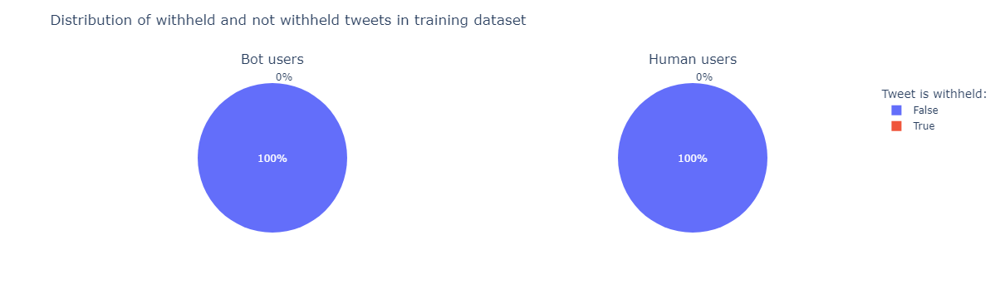

In [110]:
df_bots = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==1], col_name='withheld')
df_humans = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==0], col_name='withheld')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users","Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['withheld'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['withheld'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of withheld and not withheld tweets in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet is withheld:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

### withheld (outliers removed) - not exist all same value in column, column to drop

In [111]:
# -

Column to drop

### is_reply

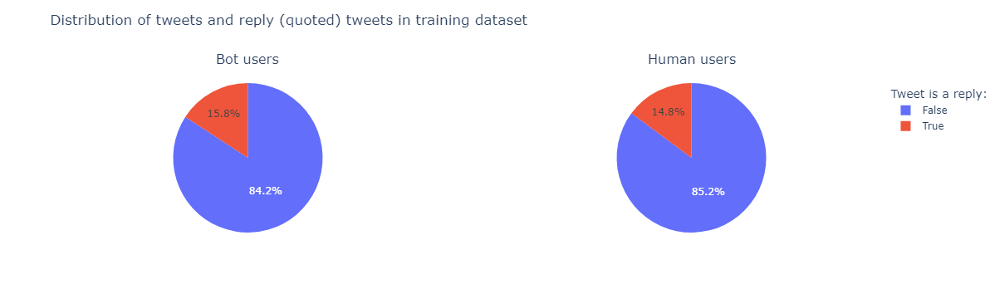

In [112]:
df_bots = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==1], col_name='is_reply')
df_humans = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==0], col_name='is_reply')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users","Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['is_reply'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['is_reply'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets and reply (quoted) tweets in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet is a reply:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

### is_reply (outliers removed)

In [113]:
train_tweets_data_is_reply_outliers = df_99_percentile_expon(df=train_tweets_data, column_name='is_reply')

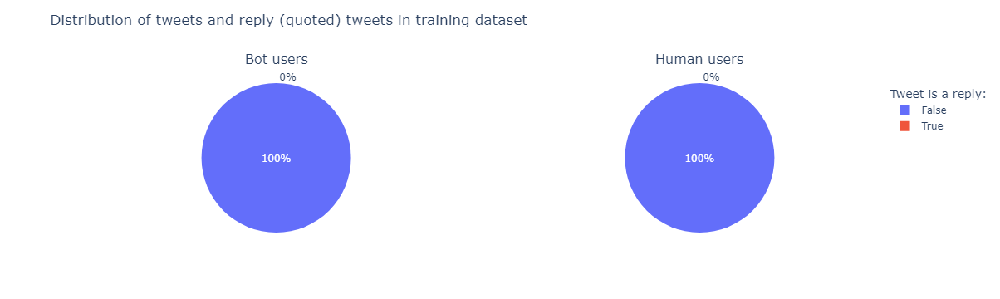

In [114]:
df_bots = get_mapped_freq_df(df=train_tweets_data_is_reply_outliers.loc[train_tweets_data_is_reply_outliers['author_label']==1], col_name='is_reply')
df_humans = get_mapped_freq_df(df=train_tweets_data_is_reply_outliers.loc[train_tweets_data_is_reply_outliers['author_label']==0], col_name='is_reply')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users","Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['is_reply'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['is_reply'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets and reply (quoted) tweets in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet is a reply:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

Column to drop

### copyright_infringement

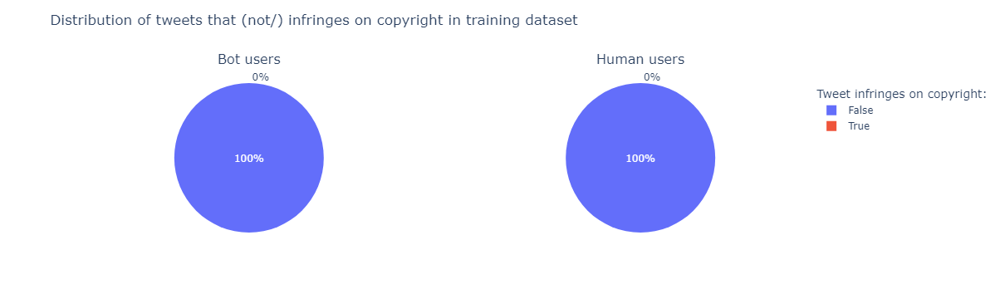

In [115]:
df_bots = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==1], col_name='copyright_infringement')
df_humans = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==0], col_name='copyright_infringement')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users","Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['copyright_infringement'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['copyright_infringement'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets that (not/) infringes on copyright in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet infringes on copyright:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

### copyright_infringement - not exist all same value in column, column to drop

In [116]:
### copyright_infringement - not exist all same value in column, column to drop

### geo_tagged

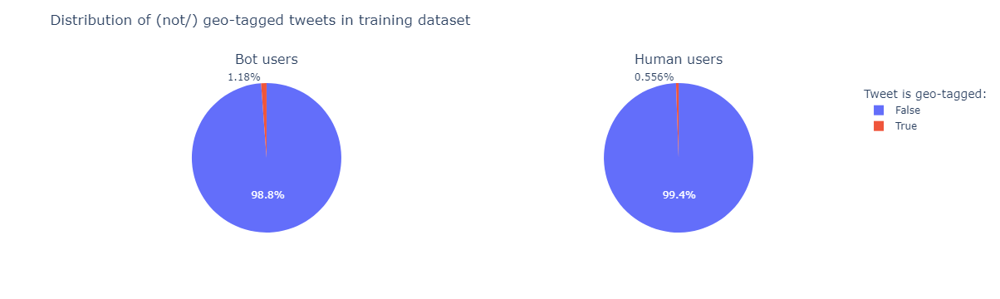

In [117]:
df_bots = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==1], col_name='geo_tagged')
df_humans = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==0], col_name='geo_tagged')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['geo_tagged'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['geo_tagged'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of (not/) geo-tagged tweets in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet is geo-tagged:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

### geo_tagged (outliers)

In [118]:
train_tweets_data_geo_tagged_outliers = df_99_percentile_expon(df=train_tweets_data, column_name='geo_tagged')

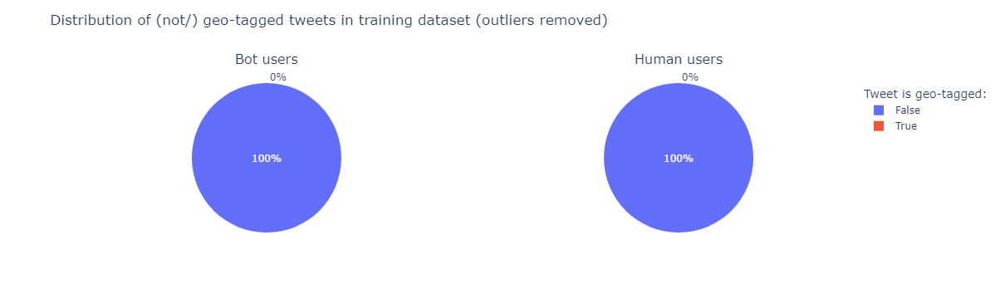

In [119]:
df_bots = get_mapped_freq_df(df=train_tweets_data_geo_tagged_outliers.loc[train_tweets_data_geo_tagged_outliers['author_label']==1], col_name='geo_tagged')
df_humans = get_mapped_freq_df(df=train_tweets_data_geo_tagged_outliers.loc[train_tweets_data_geo_tagged_outliers['author_label']==0], col_name='geo_tagged')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['geo_tagged'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['geo_tagged'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of (not/) geo-tagged tweets in training dataset (outliers removed)',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet is geo-tagged:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

Column to drop

### reply_settings

In [120]:
reply_settings_dict = {'everyone' : 0, 
                       'following' : 1, 
                       'mentionedUsers' : 2}

list(reply_settings_dict.keys())

['everyone', 'following', 'mentionedUsers']

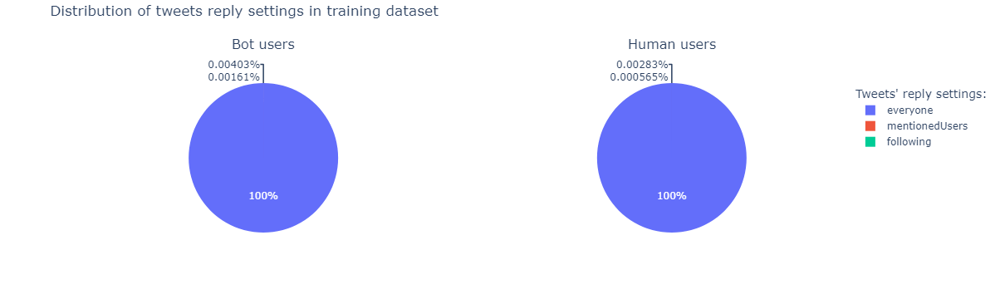

In [121]:
dd = dict(train_tweets_data.loc[train_tweets_data['author_label']==1].groupby('reply_settings').apply(lambda x: x['reply_settings'].count()))
freq1 = dd[0] if 0 in dd.keys() else 0
freq2 = dd[1] if 1 in dd.keys() else 0
freq3 = dd[2] if 2 in dd.keys() else 0
mapping = {'reply_settings' : list(reply_settings_dict.keys()),
     "freq": [freq1, freq2, freq3]}
df_bots = pd.DataFrame(mapping)

dd = dict(train_tweets_data.loc[train_tweets_data['author_label']==0].groupby('reply_settings').apply(lambda x: x['reply_settings'].count()))
freq1 = dd[0] if 0 in dd.keys() else 0
freq2 = dd[1] if 1 in dd.keys() else 0
freq3 = dd[2] if 2 in dd.keys() else 0
mapping = {'reply_settings' : list(reply_settings_dict.keys()),
     "freq": [freq1, freq2, freq3]}
df_humans = pd.DataFrame(mapping)
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users","Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['reply_settings'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['reply_settings'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets reply settings in training dataset',
    title_y=0.98,
    # width=1100,
    # height=450,
    legend={"title":"Tweets' reply settings:"}
)

fig.update_annotations({'y': 1.2}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.2}, selector={'text': 'Human users'})

fig.show()

### reply_settings (outliers removed)

In [122]:
train_tweets_data_reply_settings_outliers = df_99_percentile_expon(df=train_tweets_data, column_name='reply_settings')

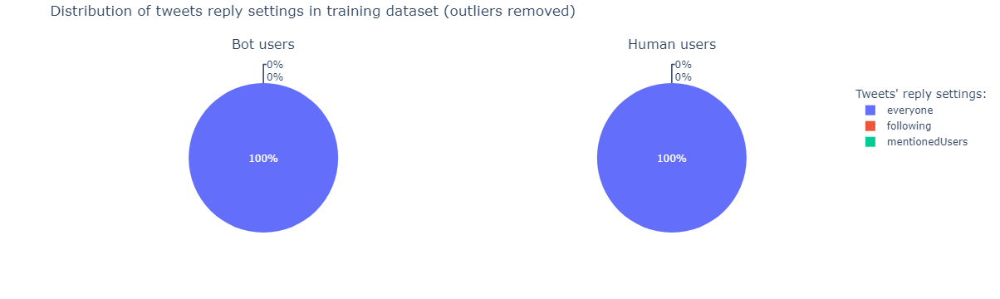

In [123]:
dd = dict(train_tweets_data_reply_settings_outliers.loc[train_tweets_data_reply_settings_outliers['author_label']==1].groupby('reply_settings').apply(lambda x: x['reply_settings'].count()))
freq1 = dd[0] if 0 in dd.keys() else 0
freq2 = dd[1] if 1 in dd.keys() else 0
freq3 = dd[2] if 2 in dd.keys() else 0
mapping = {'reply_settings' : list(reply_settings_dict.keys()),
     "freq": [freq1, freq2, freq3]}
df_bots = pd.DataFrame(mapping)

dd = dict(train_tweets_data_reply_settings_outliers.loc[train_tweets_data_reply_settings_outliers['author_label']==0].groupby('reply_settings').apply(lambda x: x['reply_settings'].count()))
freq1 = dd[0] if 0 in dd.keys() else 0
freq2 = dd[1] if 1 in dd.keys() else 0
freq3 = dd[2] if 2 in dd.keys() else 0
mapping = {'reply_settings' : list(reply_settings_dict.keys()),
     "freq": [freq1, freq2, freq3]}
df_humans = pd.DataFrame(mapping)
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users","Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['reply_settings'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['reply_settings'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets reply settings in training dataset (outliers removed)',
    title_y=0.98,
    # width=1100,
    # height=450,
    legend={"title":"Tweets' reply settings:"}
)

fig.update_annotations({'y': 1.2}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.2}, selector={'text': 'Human users'})

fig.show()

Column to drop

### any_polls_attached

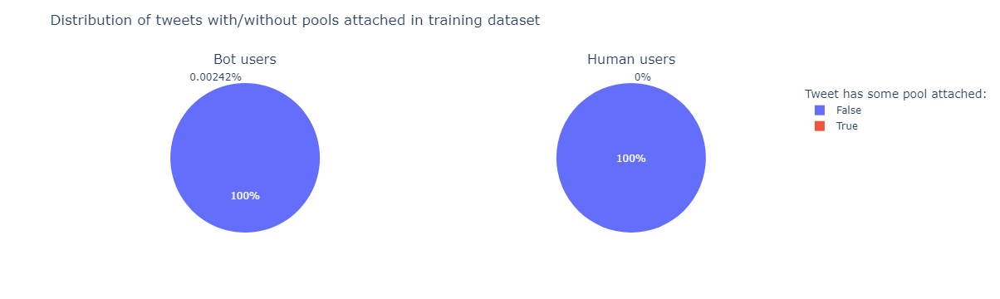

In [124]:
df_bots = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==1], col_name='any_polls_attached')
df_humans = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==0], col_name='any_polls_attached')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['any_polls_attached'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['any_polls_attached'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets with/without pools attached in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet has some pool attached:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

### any_polls_attached (outliers removed)

In [125]:
train_tweets_data_any_polls_attached_outliers = df_99_percentile_expon(df=train_tweets_data, column_name='any_polls_attached')

/opt/conda/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:2129: RuntimeWarning:

invalid value encountered in multiply



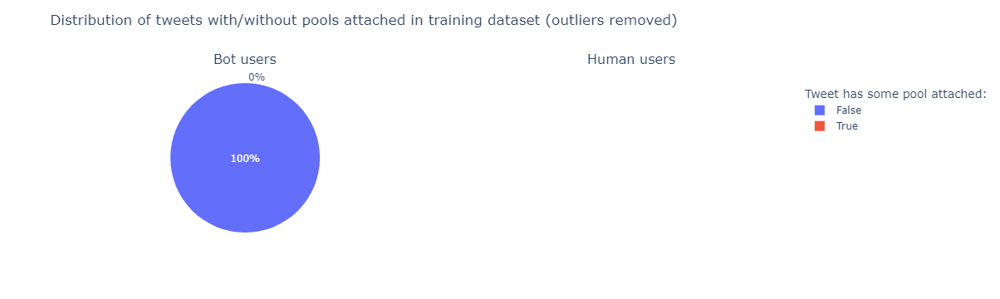

In [126]:
df_bots = get_mapped_freq_df(df=train_tweets_data_any_polls_attached_outliers.loc[train_tweets_data_any_polls_attached_outliers['author_label']==1], col_name='any_polls_attached')
df_humans = get_mapped_freq_df(df=train_tweets_data_any_polls_attached_outliers.loc[train_tweets_data_any_polls_attached_outliers['author_label']==0], col_name='any_polls_attached')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['any_polls_attached'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['any_polls_attached'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets with/without pools attached in training dataset (outliers removed)',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet has some pool attached:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

Column to drop

### any_media_attached

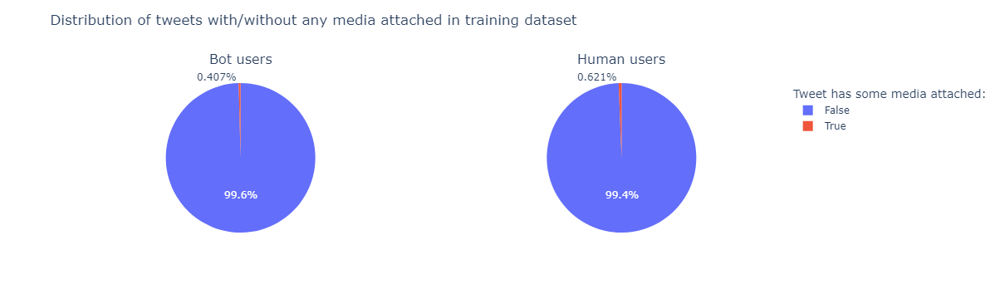

In [127]:
df_bots = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==1], col_name='any_media_attached')
df_humans = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==0], col_name='any_media_attached')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['any_media_attached'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['any_media_attached'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets with/without any media attached in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet has some media attached:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

### any_media_attached (outliers removed)

In [128]:
train_tweets_data_any_media_attached_outliers = df_99_percentile_expon(df=train_tweets_data, column_name='any_media_attached')

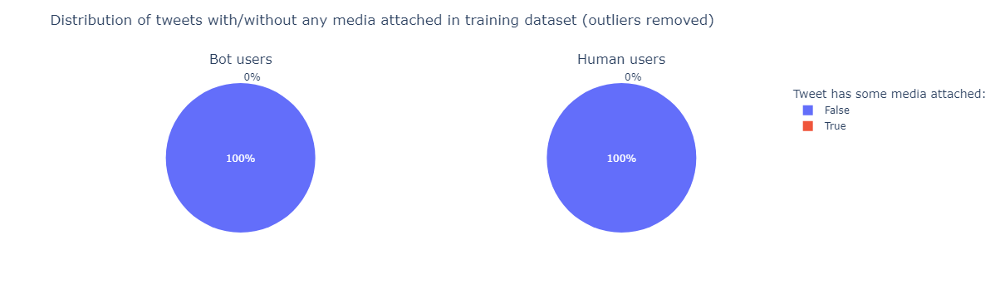

In [130]:
df_bots = get_mapped_freq_df(df=train_tweets_data_any_media_attached_outliers.loc[train_tweets_data_any_media_attached_outliers['author_label']==1], col_name='any_media_attached')
df_humans = get_mapped_freq_df(df=train_tweets_data_any_media_attached_outliers.loc[train_tweets_data_any_media_attached_outliers['author_label']==0], col_name='any_media_attached')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['any_media_attached'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['any_media_attached'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets with/without any media attached in training dataset (outliers removed)',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet has some media attached:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

Column to drop

### possibly_sensitive

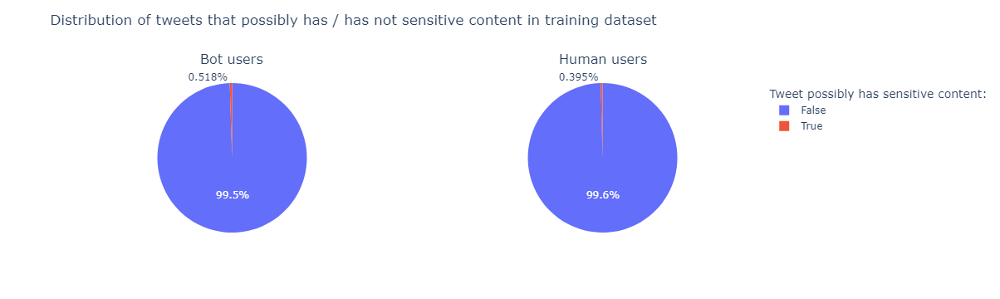

In [131]:
df_bots = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==1], col_name='possibly_sensitive')
df_humans = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==0], col_name='possibly_sensitive')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['possibly_sensitive'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['possibly_sensitive'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets that possibly has / has not sensitive content in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet possibly has sensitive content:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

### possibly_sensitive (without outliers)

In [133]:
train_tweets_data_possibly_sensitive_outliers = df_99_percentile_expon(df=train_tweets_data, column_name='possibly_sensitive')

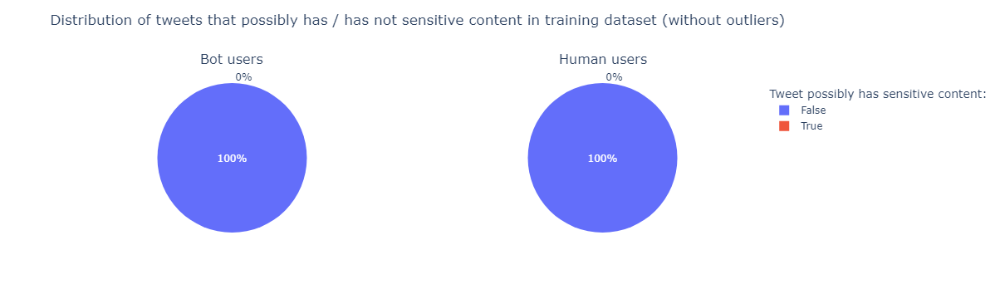

In [134]:
df_bots = get_mapped_freq_df(df=train_tweets_data_possibly_sensitive_outliers.loc[train_tweets_data_possibly_sensitive_outliers['author_label']==1], col_name='possibly_sensitive')
df_humans = get_mapped_freq_df(df=train_tweets_data_possibly_sensitive_outliers.loc[train_tweets_data_possibly_sensitive_outliers['author_label']==0], col_name='possibly_sensitive')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['possibly_sensitive'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['possibly_sensitive'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets that possibly has / has not sensitive content in training dataset (without outliers)',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet possibly has sensitive content:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

Column to drop

### has_referenced_tweets

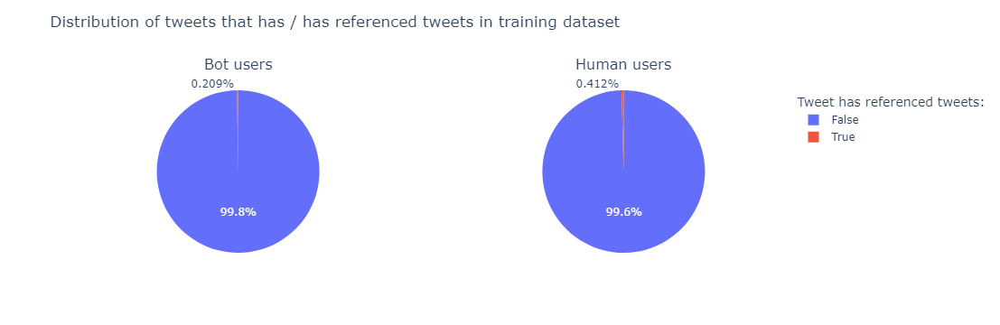

In [190]:
df_bots = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==1], col_name='has_referenced_tweets')
df_humans = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==0], col_name='has_referenced_tweets')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['has_referenced_tweets'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['has_referenced_tweets'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets that has / has referenced tweets in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet has referenced tweets:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

### contains_images

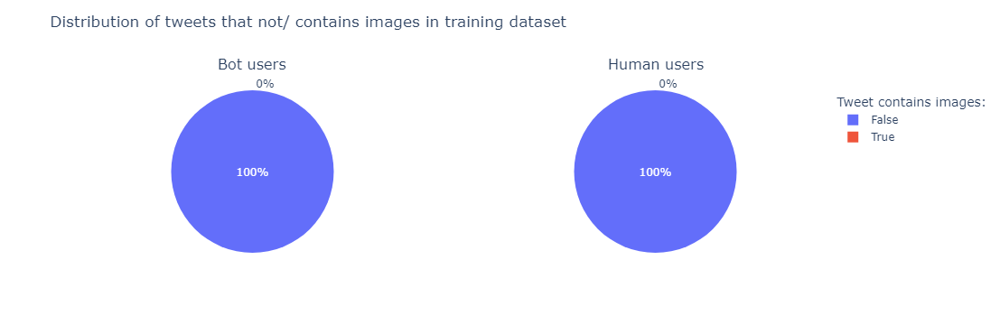

In [191]:
df_bots = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==1], col_name='contains_images')
df_humans = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==0], col_name='contains_images')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['contains_images'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['contains_images'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets that not/ contains images in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet contains images:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

### contains_annotations

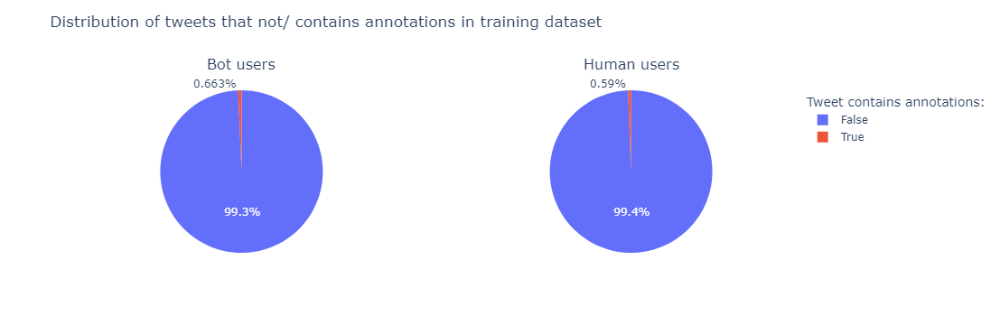

In [192]:
df_bots = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==1], col_name='contains_annotations')
df_humans = get_mapped_freq_df(df=train_tweets_data.loc[train_tweets_data['author_label']==0], col_name='contains_annotations')
# -------------------------------------------------------

fig = go.Figure()
fig = make_subplots(rows=1, 
                    cols=2, 
                    specs=[[{"type": "domain"}, {"type": "domain"}]],
                    subplot_titles=("Bot users", "Human users")
                    # specs=[[{'type':'histogram'}, {'type':'histogram'}]]
                   )

fig.add_trace(go.Pie(
    labels=df_bots['contains_annotations'], 
    values=df_bots['freq']),
row=1, col=1
)
fig.add_trace(go.Pie(
    labels=df_humans['contains_annotations'], 
    values=df_humans['freq']),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of tweets that not/ contains annotations in training dataset',
    title_y=0.95,
    # width=1100,
    # height=450,
    legend={"title":"Tweet contains annotations:"}
)

fig.update_annotations({'y': 1.1}, selector={'text': 'Bot users'})
fig.update_annotations({'y': 1.1}, selector={'text': 'Human users'})

fig.show()

### retweet_count

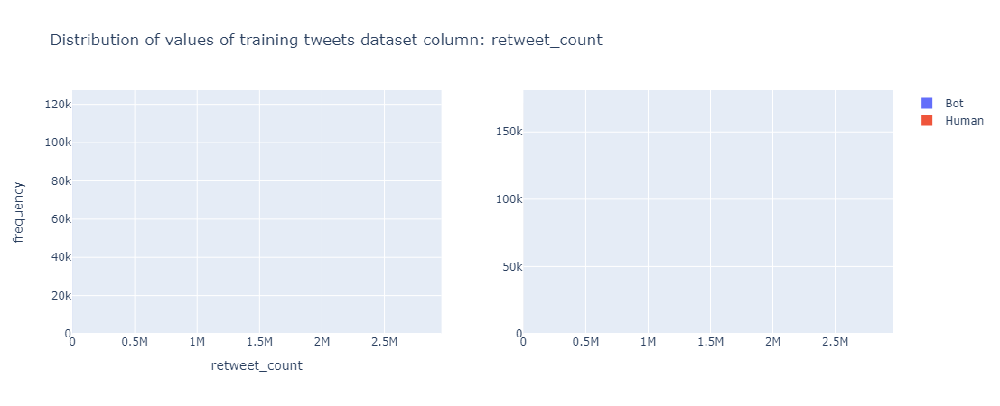

In [193]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['retweet_count'],
    # histnorm='density',
    nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['retweet_count'],
    # histnorm='density',
    nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: retweet_count',
    xaxis_title_text='retweet_count', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='retweet_count', 
               #dtick=50000, 
               # range=[0, 10000]
              ),
    xaxis2=dict(showgrid=True, 
                #dtick=100000, 
                # range=[0, 10000]
               ),
    yaxis=dict(showgrid=True))

fig.show()

### reply_count

In [194]:
train_tweets_data.loc[train_tweets_data['author_label']==1]['reply_count'].describe()

count    123973.000000
mean          0.440289
std          76.316836
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       23021.000000
Name: reply_count, dtype: float64

In [195]:
train_tweets_data.loc[train_tweets_data['author_label']==0]['reply_count'].describe()

count    176904.000000
mean          0.247140
std          20.629314
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        4456.000000
Name: reply_count, dtype: float64

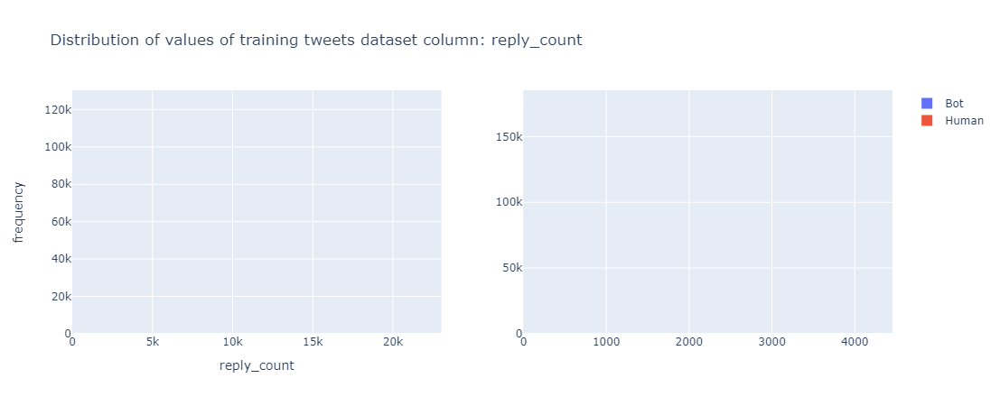

In [196]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['reply_count'],
    # histnorm='density',
    # nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['reply_count'],
    # histnorm='density',
    # nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: reply_count',
    xaxis_title_text='reply_count', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='reply_count', 
               # dtick=10, 
               range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==1]['reply_count'])]
              ),
    xaxis2=dict(showgrid=True, 
                # dtick=10, 
                range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==0]['reply_count'])]
               ),
    yaxis=dict(showgrid=True, 
               # range=[0, 100]
              ),
    yaxis2=dict(showgrid=True, 
                # range=[0, 100]
               ))

fig.show()

### like_count

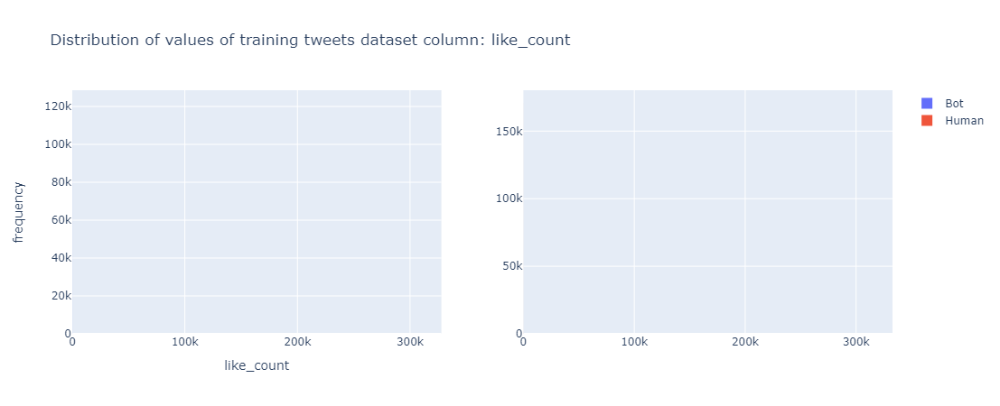

In [198]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['like_count'],
    # histnorm='density',
    # nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['like_count'],
    # histnorm='density',
    # nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: like_count',
    xaxis_title_text='like_count', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='like_count', 
               # dtick=10, 
               range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==1]['like_count'])]
              ),
    xaxis2=dict(showgrid=True, 
                # dtick=10, 
                range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==0]['like_count'])]
               ),
    yaxis=dict(showgrid=True, 
               # range=[0, 100]
              ),
    yaxis2=dict(showgrid=True, 
                # range=[0, 100]
               ))

fig.show()

## quote_count

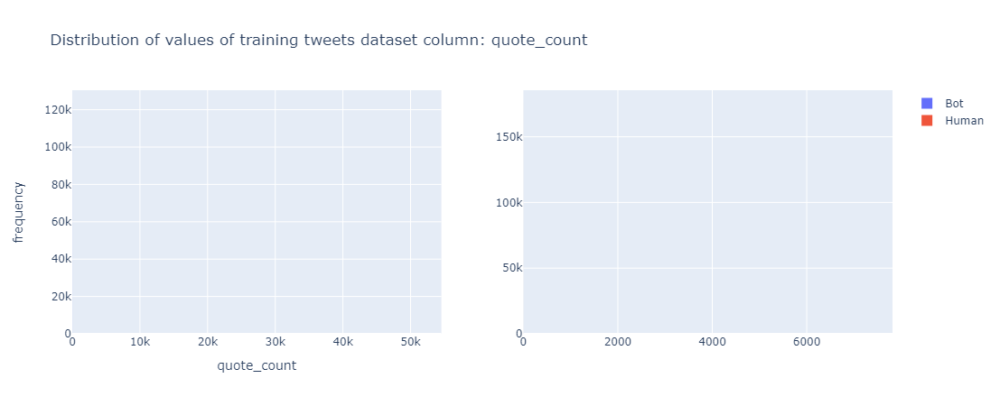

In [199]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['quote_count'],
    # histnorm='density',
    # nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['quote_count'],
    # histnorm='density',
    # nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: quote_count',
    xaxis_title_text='quote_count', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='quote_count', 
               # dtick=10, 
               range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==1]['quote_count'])]
              ),
    xaxis2=dict(showgrid=True, 
                # dtick=10, 
                range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==0]['quote_count'])]
               ),
    yaxis=dict(showgrid=True, 
               # range=[0, 100]
              ),
    yaxis2=dict(showgrid=True, 
                # range=[0, 100]
               ))

fig.show()

In [ ]:
## no_cashtags

In [ ]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['no_cashtags'],
    # histnorm='density',
    # nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['no_cashtags'],
    # histnorm='density',
    # nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: no_cashtags',
    xaxis_title_text='no_cashtags', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='no_cashtags', 
               dtick=1, 
               range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==1]['no_cashtags']+1)]
              ),
    xaxis2=dict(showgrid=True, 
                dtick=2, 
                range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==0]['no_cashtags']+1)]
               ),
    yaxis=dict(showgrid=True, 
               # range=[0, 100]
              ),
    yaxis2=dict(showgrid=True, 
                # range=[0, 100]
               ))

fig.show()

In [ ]:
## no_mentions

In [ ]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['no_mentions'],
    # histnorm='density',
    # nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['no_mentions'],
    # histnorm='density',
    # nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: no_mentions',
    xaxis_title_text='no_mentions', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='no_mentions', 
               dtick=1, 
               range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==1]['no_mentions']+1)]
              ),
    xaxis2=dict(showgrid=True, 
                dtick=1, 
                range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==0]['no_mentions']+1)]
               ),
    yaxis=dict(showgrid=True, 
               # range=[0, 100]
              ),
    yaxis2=dict(showgrid=True, 
                # range=[0, 100]
               ))

fig.show()

In [ ]:
## no_user_mentions

In [ ]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['no_user_mentions'],
    # histnorm='density',
    # nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['no_user_mentions'],
    # histnorm='density',
    # nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: no_user_mentions',
    xaxis_title_text='no_user_mentions', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='no_user_mentions', 
               dtick=5, 
               range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==1]['no_user_mentions']+5)]
              ),
    xaxis2=dict(showgrid=True, 
                dtick=5, 
                range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==0]['no_user_mentions']+5)]
               ),
    yaxis=dict(showgrid=True, 
               # range=[0, 100]
              ),
    yaxis2=dict(showgrid=True, 
                # range=[0, 100]
               ))

fig.show()

In [ ]:
## no_urls

In [ ]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['no_urls'],
    # histnorm='density',
    # nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['no_urls'],
    # histnorm='density',
    # nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: no_urls',
    xaxis_title_text='no_urls', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='no_urls', 
               dtick=1, 
               range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==1]['no_urls']+1)]
              ),
    xaxis2=dict(showgrid=True, 
                dtick=1, 
                range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==0]['no_urls']+1)]
               ),
    yaxis=dict(showgrid=True, 
               # range=[0, 100]
              ),
    yaxis2=dict(showgrid=True, 
                # range=[0, 100]
               ))

fig.show()

In [ ]:
## no_hashtags

In [ ]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['no_hashtags'],
    # histnorm='density',
    # nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['no_hashtags'],
    # histnorm='density',
    # nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: no_hashtags',
    xaxis_title_text='no_hashtags', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='no_hashtags', 
               dtick=2, 
               range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==1]['no_hashtags'])]
              ),
    xaxis2=dict(showgrid=True, 
                dtick=2, 
                range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==0]['no_hashtags'])]
               ),
    yaxis=dict(showgrid=True, 
               # range=[0, 100]
              ),
    yaxis2=dict(showgrid=True, 
                # range=[0, 100]
               ))

fig.show()

In [ ]:
## org_tweet_len

In [ ]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['org_tweet_len'],
    # histnorm='density',
    # nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['org_tweet_len'],
    # histnorm='density',
    # nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: org_tweet_len',
    xaxis_title_text='org_tweet_len', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='org_tweet_len', 
               dtick=50, 
               range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==1]['org_tweet_len']+25)]
              ),
    xaxis2=dict(showgrid=True, 
                dtick=50, 
                range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==0]['org_tweet_len']+25)]
               ),
    yaxis=dict(showgrid=True, 
               # range=[0, 100]
              ),
    yaxis2=dict(showgrid=True, 
                # range=[0, 100]
               ))

fig.show()

In [ ]:
## time_of_creation (min of the day)

In [ ]:
fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'histogram'}]])

fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==1]['org_tweet_len'],
    # histnorm='density',
    # nbinsx=10000,
    name='Bot'),
row=1, col=1
)
fig.add_trace(go.Histogram(
    x=train_tweets_data.loc[train_tweets_data['author_label']==0]['org_tweet_len'],
    # histnorm='density',
    # nbinsx=10000,
    name='Human'),
row=1, col=2
)

fig.update_layout(
    title_text='Distribution of values of training tweets dataset column: time_of_creation (UTC, in min)',
    xaxis_title_text='time_of_creation', #'feature',
    yaxis_title_text='frequency',
    bargap=0.5,
    bargroupgap=None, #0.8,
    width=1100,
    height=450,
    legend={"title":""},
    xaxis=dict(showgrid=True,title='time_of_creation', 
               dtick=60, 
               range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==1]['time_of_creation']+1)]
              ),
    xaxis2=dict(showgrid=True, 
                dtick=60, 
                range=[-0.5, max(train_tweets_data.loc[train_tweets_data['author_label']==0]['time_of_creation']+1)]
               ),
    yaxis=dict(showgrid=True, 
               # range=[0, 100]
              ),
    yaxis2=dict(showgrid=True, 
                # range=[0, 100]
               ))

fig.show()

In [ ]:
### Drop columns in dataframes where there are same value in whole columns in training dataset

In [ ]:
not_simple_numeric_col = ['id', 'author_id', 'text', 'user_mentions', 'hashtags', 'text_np', 'text_tk', 'text_seq', 'text_seq_ps']

In [ ]:
same_data_columns3 = list(train_tweets_data.drop(not_simple_numeric_col, axis=1).columns[train_tweets_data.drop(not_simple_numeric_col, axis=1).apply(lambda x: x.nunique()) == 1])
same_data_columns3

In [ ]:
train_tweets_data = train_tweets_data.drop(same_data_columns3, axis=1)

val_tweets_data = val_tweets_data.drop(same_data_columns3, axis=1)
test_tweets_data = test_tweets_data.drop(same_data_columns3, axis=1)

In [ ]:
# Text precessing

In [ ]:
#### Create backup column for text before processing

In [ ]:
train_tweets_data.loc[:, 'text_np'] = train_tweets_data['text']

In [ ]:
val_tweets_data.loc[:, 'text_np'] = val_tweets_data['text']

In [ ]:
test_tweets_data.loc[:, 'text_np'] = test_tweets_data['text']

In [ ]:
## Remove stop words and tokenize tweet text and use word embeddings

In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [ ]:
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
nltk.download('stopwords')

In [ ]:
# train_tweets_data['text_tk'] = train_tweets_data.apply(lambda row : word_tokenize(row['text']), axis=1)
# val_tweets_data['text_tk'] = train_tweets_data.apply(lambda row : word_tokenize(row['text']), axis=1)
# test_tweets_data['text_tk'] = train_tweets_data.apply(lambda row : word_tokenize(row['text']), axis=1)

In [ ]:
train_tweets_data.loc[:, 'text_tk'] = train_tweets_data['text'].apply(lambda text : word_tokenize(text))
val_tweets_data.loc[:, 'text_tk'] = val_tweets_data['text'].apply(lambda text : word_tokenize(text))
test_tweets_data.loc[:, 'text_tk'] = test_tweets_data['text'].apply(lambda text : word_tokenize(text))

In [ ]:
### Remove stopwords

In [ ]:
stop_words = stopwords.words('english')

In [ ]:
train_tweets_data.loc[:, 'text_tk'] = train_tweets_data['text_tk'].apply(lambda words: [word for word in words if word not in stop_words])
val_tweets_data.loc[:, 'text_tk'] = val_tweets_data['text_tk'].apply(lambda words: [word for word in words if word not in stop_words])
test_tweets_data.loc[:, 'text_tk'] = test_tweets_data['text_tk'].apply(lambda words: [word for word in words if word not in stop_words])

In [ ]:
#### To not have additional spaces

In [ ]:
train_tweets_data.loc[:, 'text'] = train_tweets_data['text_tk'].apply(lambda words : ' '.join(words))
val_tweets_data.loc[:, 'text'] = val_tweets_data['text_tk'].apply(lambda words : ' '.join(words))
test_tweets_data.loc[:, 'text'] = test_tweets_data['text_tk'].apply(lambda words : ' '.join(words))

In [ ]:
### Word Embedding

In [ ]:
# !wget http://nlp.stanford.edu/data/glove.6B.zip
# !unzip glove.6B.zip

In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [ ]:
tokenizer = Tokenizer()
tokenizer.fit_on_texts(train_tweets_data['text'])
word_index = tokenizer.word_index

num_words = len(word_index) + 1  # adding 1 for padding token
embedding_dim = 100              # using GloVe 100-dimensional vectors

In [ ]:
### Integer encode text

In [ ]:
train_tweets_data.loc[:, 'text_seq'] = train_tweets_data['text'].apply(lambda text:  tokenizer.texts_to_sequences([text])[0])
val_tweets_data.loc[:, 'text_seq'] = val_tweets_data['text'].apply(lambda text: tokenizer.texts_to_sequences([text])[0])
test_tweets_data.loc[:, 'text_seq'] = test_tweets_data['text'].apply(lambda text: tokenizer.texts_to_sequences([text])[0])

In [ ]:
### Pad encoded text to a max length 

In [ ]:
max_length_train = train_tweets_data['text_seq'].apply(len).max()
max_length_val = val_tweets_data['text_seq'].apply(len).max()
max_length_test = test_tweets_data['text_seq'].apply(len).max()

In [ ]:
max_length_train

In [ ]:
max_length_val

In [ ]:
max_length_test

In [ ]:
train_tweets_data['text_seq'].apply(len).mean()

In [ ]:
val_tweets_data['text_seq'].apply(len).mean()

In [ ]:
test_tweets_data['text_seq'].apply(len).mean()

In [ ]:
max_length = 30  # max_length_train

In [ ]:
train_tweets_data.loc[:, 'text_seq_ps'] = train_tweets_data['text_seq'].apply(lambda encoded: pad_sequences([encoded], maxlen=max_length, padding='post'))
val_tweets_data.loc[:, 'text_seq_ps'] = val_tweets_data['text_seq'].apply(lambda encoded: pad_sequences([encoded], maxlen=max_length, padding='post'))
test_tweets_data.loc[:, 'text_seq_ps'] = test_tweets_data['text_seq'].apply(lambda encoded: pad_sequences([encoded], maxlen=max_length, padding='post'))

In [ ]:
#### Load GloVe embedding

In [ ]:
embeddings_index = {}
with open('glove.6B.100d.txt', encoding='utf-8') as f:
    for line in f:
        values = line.split()
        word = values[0]
        coefs = np.asarray(values[1:], dtype='float32')
        embeddings_index[word] = coefs

In [ ]:
print('Loaded %s word vectors.' % len(embeddings_index))

In [ ]:
#### Creating a weight matrix for words

In [ ]:
embedding_matrix = np.zeros((num_words, embedding_dim))

for word, i in word_index.items():
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector

In [ ]:
### Standardize other tweets data by column range of training set

In [ ]:
train_tweets_data.columns

In [ ]:
def standardize_column(df, col_name, mean_training, std_training):
    df_cp = df.copy()
    df_cp[col_name] = (df[col_name] - mean_training) / std_training

    return df_cp

In [ ]:
#### Standardize

In [ ]:
for column_name in columns_to_standardize:
    mean_training = train_tweets_data[column_name].mean()
    std_training = train_tweets_data[column_name].std()
    print(column_name)
    print("mean_training = ", mean_training)
    print("std_training = ", std_training)
    print()
    
    train_tweets_data = standardize_column(train_tweets_data, column_name, mean_training, std_training)
    val_tweets_data = standardize_column(val_tweets_data, column_name, mean_training, std_training)
    test_tweets_data = standardize_column(test_tweets_data, column_name, mean_training, std_training)

In [ ]:
## Correlation of numeric tweets data

In [ ]:
sns.set(font_scale=0.7)

In [ ]:
corr_threshold = 0.52
corr = train_tweets_data[columns_to_standardize].corr()
lower_tri = corr.where(np.tril(np.ones(corr.shape),k=-1).astype(bool)) #creating lower triangular correlation matrix
f = plt.figure(figsize=(20, 15))
sns.heatmap(lower_tri, cmap="PiYG", annot=True, vmin=-1, vmax=1, ax=plt.gca()) #, annot_kws={"fontsize": 16})
high_corr3 = []
for column in train_tweets_data[columns_to_standardize]:
   for col in train_tweets_data[columns_to_standardize]:
     if abs(lower_tri[column][col]) > corr_threshold:
         high_corr3.append((column, col, lower_tri[column][col]))
high_corr3 = sorted(high_corr3, key=lambda x: x[2], reverse=True)

In [ ]:
sns.set(font_scale=1)

In [ ]:
print("Number of columns containing high correlation:", len(set([x[0] for x in high_corr3])))
high_corr3

In [ ]:
train_tweets_data = train_tweets_data.drop(['cleaned_tweet_len', 'quote_count'], axis=1)

In [ ]:
val_tweets_data = val_tweets_data.drop(['cleaned_tweet_len', 'quote_count'], axis=1)

In [ ]:
test_tweets_data = test_tweets_data.drop(['cleaned_tweet_len', 'quote_count'], axis=1)

In [ ]:
all_curr_col = train_tweets_data.columns
simple_num_cols = [c for c in columns_to_standardize if c in all_curr_col]

In [ ]:
##  Extend users dataset to match every single tweet in tweets dataset

In [ ]:
train_users_data_extended1 = train_tweets_data[['author_id']]
train_users_data_extended = train_users_data_extended1 = pd.merge(train_users_data_extended1, train_users_data, left_on="author_id", right_on="id")
train_users_data_extended = train_users_data_extended.drop(['author_id'], axis=1)

val_users_data_extended1 = val_tweets_data[['author_id']]
val_users_data_extended = val_users_data_extended1 = pd.merge(val_users_data_extended1, val_users_data, left_on="author_id", right_on="id")
val_users_data_extended = val_users_data_extended.drop(['author_id'], axis=1)

test_users_data_extended1 = test_tweets_data[['author_id']]
test_users_data_extended = test_users_data_extended1 = pd.merge(test_users_data_extended1, test_users_data, left_on="author_id", right_on="id")
test_users_data_extended = test_users_data_extended.drop(['author_id'], axis=1)

In [ ]:
## Split user data for input and output

In [ ]:
train_users_X = train_users_data_extended.drop(['label'], axis=1)
train_users_Y = pd.concat([train_users_data_extended['label']], axis=1)
val_users_X = val_users_data_extended.drop(['label'], axis=1)
val_users_Y = pd.concat([val_users_data_extended['label']], axis=1)
test_users_X = test_users_data_extended.drop(['label'], axis=1)
test_users_Y = pd.concat([test_users_data_extended['label']], axis=1)

In [ ]:
train_users_X = train_users_data_extended.drop(['label'], axis=1)
train_users_Y = pd.concat([train_users_data_extended['label']], axis=1)
val_users_X = val_users_data_extended.drop(['label'], axis=1)
val_users_Y = pd.concat([val_users_data_extended['label']], axis=1)
test_users_X = test_users_data_extended.drop(['label'], axis=1)
test_users_Y = pd.concat([test_users_data_extended['label']], axis=1)

In [ ]:
## Convert to tensors

In [ ]:
train_tweets_text_data_tensor = tf.convert_to_tensor(train_tweets_data['text_seq_ps'].apply(lambda x: x[0]).tolist(), dtype=tf.float32)
train_tweets_add_feat_data_tensor = tf.convert_to_tensor(train_tweets_data[simple_num_cols].values, dtype=tf.float32)
train_users_X_tensor = tf.convert_to_tensor(train_users_X.values, dtype=tf.float32)

In [ ]:
val_tweets_text_data_tensor = tf.convert_to_tensor(val_tweets_data['text_seq_ps'].apply(lambda x: x[0]).tolist(), dtype=tf.float32)
val_tweets_add_feat_data_tensor = tf.convert_to_tensor(val_tweets_data[simple_num_cols].values, dtype=tf.float32)
val_users_X_tensor = tf.convert_to_tensor(val_users_X.values, dtype=tf.float32)

test_tweets_text_data_tensor = tf.convert_to_tensor(test_tweets_data['text_seq_ps'].apply(lambda x: x[0]).tolist(), dtype=tf.float32)
test_tweets_add_feat_data_tensor = tf.convert_to_tensor(test_tweets_data[simple_num_cols].values, dtype=tf.float32)
test_users_X_tensor = tf.convert_to_tensor(test_users_X.values, dtype=tf.float32)

In [ ]:
------
------

In [ ]:
# DNN models

In [ ]:
#### Function to load a saved neural network model

In [ ]:
from keras.models import load_model

def load_model_from_file(filepath):
  model = load_model(filepath)
  return model

In [ ]:
#### Summary of metrics based on real and predicted data by the network

In [ ]:
def get_model_metrics(test_Y, out_Y):
  accuracy = accuracy_score(test_Y, out_Y)
  print('Accuracy: {}'.format(accuracy))
  # precision tp / (tp + fp)
  precision = precision_score(test_Y, out_Y, average=None)
  print('Precision: {}'.format(precision))
  # recall: tp / (tp + fn)
  recall = recall_score(test_Y, out_Y)
  print('Recall: {}'.format(recall))
  # f1: 2 tp / (2 tp + fp + fn)
  f1 = f1_score(test_Y, out_Y)
  print('F1 score: %f' % f1)
  # ROC AUC
  auc = roc_auc_score(test_Y, out_Y)
  print('ROC AUC: %f' % auc)
  return (accuracy, precision, recall, f1, auc)

In [ ]:
#### Creating a confusion matrix

In [ ]:
def create_confusion_matrix(test_Y, out_Y):
    cm = sklearn.metrics.confusion_matrix(test_Y, out_Y)

    group_counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in cm.flatten()/np.sum(cm)]
    labels = [f"{v1}\n\n{v2}" for v1, v2 in zip(group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)

    plt.figure()
    fig = plt.figure(figsize=(4,4))
    ax = fig.add_subplot(111)

    sns.heatmap(
        cm,
        annot=labels,
        annot_kws={"size": 12},
        fmt='',
        cmap=plt.cm.Blues,
        cbar=False
    )
    ax.set_title("Confusion matrix", fontsize=14)
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=12)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=12)
    ax.set_ylabel('True', fontsize=12)
    ax.set_xlabel('Predicted', fontsize=12)
    
    fig.show()

In [ ]:
## Neural network models 

In [ ]:
from tensorflow.keras.layers import Embedding, LSTM, Dense, Dropout, Input, Concatenate, concatenate

In [ ]:
# EarlyStopping
def early_stop(metric='val_accuracy', mode = 'max', patience=50):
    return EarlyStopping(monitor='val_accuracy',
                           patience=patience,
                           restore_best_weights=True,
                           mode=mode)
# PlotLosses
def plot_losses():
    return PlotLossesCallback()

# ModelCheckpoint
def checkpoint_callback(model_name):
    return ModelCheckpoint(filepath = models_path + '/' + model_name + '.hdf5',
                            monitor = "val_accuracy",
                            save_best_only = True,
                            # save_weights_only = True,
                            verbose=1)

In [ ]:
def train_model(model, model_name, train_X, train_Y, val_X, val_Y, batch_size, epochs):
    model.fit(train_X, train_Y, batch_size=batch_size, epochs=epochs,
                validation_data=(val_X, val_Y),
                callbacks=[plot_losses(),
                           early_stop(),
                           checkpoint_callback(model_name)])
    return model

In [ ]:
def prediction_and_metrics(model, test_X, test_Y):
    out_Y_org = model.predict(test_X, verbose=0)
    out_Y = [0 if x < 0.5 else 1 for x in out_Y_org]

    x = range(0, len(test_Y))
    fig = plt.figure(figsize=(18, 4))
    colors = ['blue' if val == 0. else 'red' for val in np.asarray(test_Y)]
    plt.scatter(x, out_Y_org, marker='.', label ='predicted', c=colors)
    plt.plot(x, [0.5] * len(test_Y), c='orange')
    plt.ylim((0,1))

    create_confusion_matrix(test_Y, out_Y)
    get_model_metrics(test_Y, out_Y)

In [ ]:
## Model 1.

In [ ]:
#### Create model

In [ ]:
def create_model_1(num_words, embedding_dim, embedding_matrix, max_sequence_length, trainable=False,
                  add_tweets_feat_size=(18,), add_user_feat_size=(6,), optimizer=tf.keras.optimizers.Adam(learning_rate=0.001)):
    
    # Text input
    text_input = Input(shape=(max_sequence_length,))
    # Embedding layer for text
    embedding_layer = Embedding(num_words, embedding_dim, weights=[embedding_matrix], input_length=max_sequence_length, trainable=trainable)(text_input)
    # LSTM layer
    lstm_layer = LSTM(64)(embedding_layer)
    
    # Additional tweet's features input
    additional_tweet_input = Input(shape=(add_tweets_feat_size,)) 
    # Additional user's features input
    additional_user_input = Input(shape=(add_user_feat_size,)) 
    
    # Concatenate text and additional features
    concatenated = concatenate([lstm_layer, additional_tweet_input, additional_user_input])
    
    dense_layer1 = Dense(128)(concatenated)
    activation_layer1 = Activation('relu')(dense_layer1)
    dropout_layer1 = Dropout(0.5)(dense_layer1)
    dense_layer2 = Dense(64)(dropout_layer1)
    activation_layer2 = Activation('relu')(dense_layer2)
    output_layer = Dense(1, activation='sigmoid')(activation_layer2)
    
    model = Model(inputs=[text_input, additional_tweet_input, additional_user_input], outputs=output_layer)
    
    model.compile(optimizer=optimizer, loss=keras.losses.BinaryCrossentropy(), metrics=['accuracy'])

    return model

In [ ]:
### batch_size=200, epochs=10

In [ ]:
#### Create and train model

In [ ]:
model_name = 'model_users_and_tweets_data_based_10000_1_v1_batch_size_200_user_data_and_single_tweet_glove'
tweets_numeric_subset_size = train_tweets_data[simple_num_cols].shape[1]
users_set_size = train_users_X.shape[1]

model1 = create_model_1(num_words=num_words, embedding_dim=embedding_dim, 
                       embedding_matrix=embedding_matrix, max_sequence_length=max_length, 
                       trainable=False, 
                       add_tweets_feat_size=tweets_numeric_subset_size, #dense_layer1=64, 
                       add_user_feat_size=users_set_size,
                       optimizer=tf.keras.optimizers.Adam(learning_rate=0.001))


In [ ]:
model1 =  train_model(model1, 
                      model_name, 
                      train_X=[train_tweets_text_data_tensor, train_tweets_add_feat_data_tensor, train_users_X_tensor], 
                      train_Y=train_users_Y, 
                      val_X=[val_tweets_text_data_tensor, val_tweets_add_feat_data_tensor, val_users_X_tensor], 
                      val_Y=val_users_Y, 
                      batch_size=200, 
                      epochs=10)

In [ ]:
#### Prediction and results

In [ ]:
prediction_and_metrics(model1, [test_tweets_text_data_tensor, test_tweets_add_feat_data_tensor, test_users_X_tensor], test_users_Y)

In [ ]:
## Model 2.

In [ ]:
#### Create and train model

In [ ]:
def create_model_2(num_words, embedding_dim, embedding_matrix, max_sequence_length, trainable=False,
                  add_tweets_feat_size=(18,), add_user_feat_size=(6,), optimizer=tf.keras.optimizers.Adam(learning_rate=0.001)):
    
    # # Text input
    # text_input = Input(shape=(max_sequence_length,))
    # # Embedding layer for text
    # embedding_layer = Embedding(num_words, embedding_dim, weights=[embedding_matrix], input_length=max_sequence_length, trainable=trainable)(text_input)
    # # LSTM layer
    # lstm_layer = LSTM(64)(embedding_layer)
    
    # Additional tweet's features input
    additional_tweet_input = Input(shape=(add_tweets_feat_size,)) 
    # Additional user's features input
    additional_user_input = Input(shape=(add_user_feat_size,)) 
    
    # Concatenate text and additional features
    # concatenated = concatenate([lstm_layer, additional_tweet_input, additional_user_input])
    concatenated = concatenate([additional_tweet_input, additional_user_input])
    
    dense_layer1 = Dense(128)(concatenated)
    activation_layer1 = Activation('relu')(dense_layer1)
    dropout_layer1 = Dropout(0.5)(dense_layer1)
    dense_layer2 = Dense(64)(dropout_layer1)
    activation_layer2 = Activation('relu')(dense_layer2)
    output_layer = Dense(1, activation='sigmoid')(activation_layer2)
    
    # model = Model(inputs=[text_input, additional_tweet_input, additional_user_input], outputs=output_layer)
    model = Model(inputs=[additional_tweet_input, additional_user_input], outputs=output_layer)
    
    model.compile(optimizer=optimizer, loss=keras.losses.BinaryCrossentropy(), metrics=['accuracy'])

    return model

In [ ]:
model_name = 'model_users_and_tweets_data_based_10000_2_v1_batch_size_200_user_data_and_single_tweet_glove'
tweets_numeric_subset_size = train_tweets_data[simple_num_cols].shape[1]
users_set_size = train_users_X.shape[1]

model2 = create_model_2(num_words=num_words, embedding_dim=embedding_dim, 
                       embedding_matrix=embedding_matrix, max_sequence_length=max_length, 
                       trainable=False, 
                       add_tweets_feat_size=tweets_numeric_subset_size, #dense_layer1=64, 
                       add_user_feat_size=users_set_size,
                       optimizer=tf.keras.optimizers.Adam(learning_rate=0.001))


In [ ]:
model_name = 'model_users_and_tweets_data_based_10000_2_v1_batch_size_200_user_data_and_single_tweet_glove'
tweets_numeric_subset_size = train_tweets_data[simple_num_cols].shape[1]
users_set_size = train_users_X.shape[1]

model2 = create_model_2(num_words=num_words, embedding_dim=embedding_dim, 
                       embedding_matrix=embedding_matrix, max_sequence_length=max_length, 
                       trainable=False, 
                       add_tweets_feat_size=tweets_numeric_subset_size, #dense_layer1=64, 
                       add_user_feat_size=users_set_size,
                       optimizer=tf.keras.optimizers.Adam(learning_rate=0.001))


In [ ]:
#### Prediction and results

In [ ]:
# prediction_and_metrics(model2, [test_tweets_text_data_tensor, test_tweets_add_feat_data_tensor, test_users_X_tensor], test_users_Y)
prediction_and_metrics(model2, [test_tweets_add_feat_data_tensor, test_users_X_tensor], test_users_Y)

In [ ]:
## Model 3.

In [ ]:
#### Create and train model

In [ ]:
def create_model_3(num_words, embedding_dim, embedding_matrix, max_sequence_length, trainable=False,
                  add_tweets_feat_size=(18,), add_user_feat_size=(6,), optimizer=tf.keras.optimizers.Adam(learning_rate=0.001)):
    
    # # Text input
    # text_input = Input(shape=(max_sequence_length,))
    # # Embedding layer for text
    # embedding_layer = Embedding(num_words, embedding_dim, weights=[embedding_matrix], input_length=max_sequence_length, trainable=trainable)(text_input)
    # # LSTM layer
    # lstm_layer = LSTM(64)(embedding_layer)
    
    # Additional tweet's features input
    additional_tweet_input = Input(shape=(add_tweets_feat_size,)) 
    # Additional user's features input
    additional_user_input = Input(shape=(add_user_feat_size,)) 
    
    # Concatenate text and additional features
    # concatenated = concatenate([lstm_layer, additional_tweet_input, additional_user_input])
    concatenated = concatenate([additional_tweet_input, additional_user_input])
    
    dense_layer1 = Dense(64)(concatenated)
    activation_layer1 = Activation('relu')(dense_layer1)
    dropout_layer1 = Dropout(0.1)(dense_layer1)
    dense_layer2 = Dense(64)(dropout_layer1)
    activation_layer2 = Activation('relu')(dense_layer2)
    output_layer = Dense(1, activation='sigmoid')(activation_layer2)
    
    # model = Model(inputs=[text_input, additional_tweet_input, additional_user_input], outputs=output_layer)
    model = Model(inputs=[additional_tweet_input, additional_user_input], outputs=output_layer)
    
    model.compile(optimizer=optimizer, loss=keras.losses.BinaryCrossentropy(), metrics=['accuracy'])

    return model

In [ ]:
model_name = 'model_users_and_tweets_data_based_10000_3_v1_batch_size_200_user_data_and_single_tweet_glove'
tweets_numeric_subset_size = train_tweets_data[simple_num_cols].shape[1]
users_set_size = train_users_X.shape[1]

model3 = create_model_3(num_words=num_words, embedding_dim=embedding_dim, 
                       embedding_matrix=embedding_matrix, max_sequence_length=max_length, 
                       trainable=False, 
                       add_tweets_feat_size=tweets_numeric_subset_size, #dense_layer1=64, 
                       add_user_feat_size=users_set_size,
                       optimizer=tf.keras.optimizers.Adam(learning_rate=0.001))


In [ ]:
model3 =  train_model(model3, 
                      model_name, 
                      train_X=[train_tweets_add_feat_data_tensor, train_users_X_tensor], 
                      train_Y=train_users_Y, 
                      val_X=[val_tweets_add_feat_data_tensor, val_users_X_tensor], 
                      val_Y=val_users_Y, 
                      batch_size=512, 
                      epochs=100)

In [ ]:
#### Prediction and results

In [ ]:
# prediction_and_metrics(model2, [test_tweets_text_data_tensor, test_tweets_add_feat_data_tensor, test_users_X_tensor], test_users_Y)
prediction_and_metrics(model3, [test_tweets_add_feat_data_tensor, test_users_X_tensor], test_users_Y)

In [ ]:
## Model 4.

In [ ]:
def train_model(model, model_name, train_X, train_Y, val_X, val_Y, batch_size, epochs):
    model.fit(train_X, train_Y, batch_size=batch_size, epochs=epochs,
                validation_data=(val_X, val_Y),
                callbacks=[plot_losses(metric='val_accuracy', mode = 'max', patience=200),
                           early_stop(),
                           checkpoint_callback(model_name)])
    return model

In [ ]:
#### Create and train model

In [ ]:
def create_model_4(num_words, embedding_dim, embedding_matrix, max_sequence_length, trainable=False,
                  add_tweets_feat_size=(18,), add_user_feat_size=(6,), optimizer=tf.keras.optimizers.Adam(learning_rate=0.001)):
    
    # # Text input
    # text_input = Input(shape=(max_sequence_length,))
    # # Embedding layer for text
    # embedding_layer = Embedding(num_words, embedding_dim, weights=[embedding_matrix], input_length=max_sequence_length, trainable=trainable)(text_input)
    # # LSTM layer
    # lstm_layer = LSTM(64)(embedding_layer)
    
    # Additional tweet's features input
    additional_tweet_input = Input(shape=(add_tweets_feat_size,)) 
    # Additional user's features input
    additional_user_input = Input(shape=(add_user_feat_size,)) 
    
    # Concatenate text and additional features
    # concatenated = concatenate([lstm_layer, additional_tweet_input, additional_user_input])
    concatenated = concatenate([additional_tweet_input, additional_user_input])
    
    dense_layer1 = Dense(64)(concatenated)
    activation_layer1 = Activation('relu')(dense_layer1)
    dropout_layer1 = Dropout(0.1)(dense_layer1)
    dense_layer2 = Dense(32)(dropout_layer1)
    activation_layer2 = Activation('relu')(dense_layer2)
    output_layer = Dense(1, activation='sigmoid')(activation_layer2)
    
    # model = Model(inputs=[text_input, additional_tweet_input, additional_user_input], outputs=output_layer)
    model = Model(inputs=[additional_tweet_input, additional_user_input], outputs=output_layer)
    
    model.compile(optimizer=optimizer, loss=keras.losses.BinaryCrossentropy(), metrics=['accuracy'])

    return model

In [ ]:
model_name = 'model_users_and_tweets_data_based_10000_4_v1_batch_size_200_user_data_and_single_tweet_glove'
tweets_numeric_subset_size = train_tweets_data[simple_num_cols].shape[1]
users_set_size = train_users_X.shape[1]

model4 = create_model_4(num_words=num_words, embedding_dim=embedding_dim, 
                       embedding_matrix=embedding_matrix, max_sequence_length=max_length, 
                       trainable=False, 
                       add_tweets_feat_size=tweets_numeric_subset_size, #dense_layer1=64, 
                       add_user_feat_size=users_set_size,
                       optimizer=tf.keras.optimizers.Adam(learning_rate=0.001))


In [ ]:
model4 =  train_model(model4, 
                      model_name, 
                      train_X=[train_tweets_add_feat_data_tensor, train_users_X_tensor], 
                      train_Y=train_users_Y, 
                      val_X=[val_tweets_add_feat_data_tensor, val_users_X_tensor], 
                      val_Y=val_users_Y, 
                      batch_size=512, 
                      epochs=1000)

In [ ]:
#### Prediction and results

In [ ]:
# prediction_and_metrics(model2, [test_tweets_text_data_tensor, test_tweets_add_feat_data_tensor, test_users_X_tensor], test_users_Y)
prediction_and_metrics(model4, [test_tweets_add_feat_data_tensor, test_users_X_tensor], test_users_Y)